<a href="https://colab.research.google.com/github/NicolasRuiz889/Proyecto_final_sistemas_distribuidos_2025/blob/main/Copia_de_2025_07_07_file_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

\# MODELO DE PREDICCIÓN PARA OFFERED CALLS


\#\#\# 1. Importación de librerias


In [ ]:
#==============================================================================
# ⚙️ Configuración inicial
# ==============================================================================
import warnings
warnings.filterwarnings('once')

# Colores para impresión
color = '\033[1m\033[38;5;208m'

# ==============================================================================
# 🧮 Librerías base
# ==============================================================================
import numpy as np
import pandas as pd
import re
from io import StringIO
import contextlib

# ==============================================================================
# 📊 Visualización
# ==============================================================================
import matplotlib.pyplot as plt
plt.style.use('seaborn-v0_8-darkgrid')
plt.rcParams.update({'font.size': 8})

import plotly.graph_objects as go
import plotly.io as pio
import plotly.offline as poff
pio.templates.default = "seaborn"
poff.init_notebook_mode(connected=True)

# Statsmodels
from statsmodels.tsa.seasonal import STL
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.tsa.seasonal import seasonal_decompose

# skforecast visual tools
from skforecast.plot import (
    plot_residuals,
    calculate_lag_autocorrelation,
    set_dark_theme
)

# ==============================================================================
# 📦 Librerías de modelos y forecasting
# ==============================================================================
import sklearn
from sklearn.preprocessing import PolynomialFeatures
from sklearn.feature_selection import RFECV

import lightgbm
from lightgbm import LGBMRegressor

import shap

# skforecast (forecasting con regresores)
import skforecast
from skforecast.datasets import fetch_dataset
from skforecast.feature_selection import select_features
from skforecast.preprocessing import RollingFeatures
from skforecast.model_selection import (
    TimeSeriesFold,
    backtesting_forecaster,
    backtesting_sarimax,
    bayesian_search_forecaster,
    grid_search_sarimax
)
from skforecast.direct import ForecasterDirect
from skforecast.recursive import (
    ForecasterRecursive,
    ForecasterEquivalentDate,
    ForecasterSarimax
)
from skforecast.metrics import calculate_coverage
from skforecast.sarimax import Sarimax

# ==============================================================================
# 🕒 Ingeniería de características temporales
# ==============================================================================
from feature_engine.datetime import DatetimeFeatures
from feature_engine.creation import CyclicalFeatures
from feature_engine.timeseries.forecasting import WindowFeatures

# Astral para variables solares
from astral import LocationInfo
from astral.sun import sun

# ==============================================================================
# 🔎 Mostrar versiones principales
# ==============================================================================
print(f"{color}Version skforecast: {skforecast.__version__}")
print(f"{color}Version scikit-learn: {sklearn.__version__}")
print(f"{color}Version lightgbm: {lightgbm.__version__}")
print(f"{color}Version pandas: {pd.__version__}")
print(f"{color}Version numpy: {np.__version__}")

c:\Users\nicol\AppData\Local\Programs\Python\Python39\lib\site-packages\_plotly_utils\basevalidators.py:2596: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



Version skforecast: 0.16.0
Version scikit-learn: 1.6.1
Version lightgbm: 4.6.0
Version pandas: 2.2.3
Version numpy: 2.0.2


In [ ]:
# 1. CARGA DE DATOS
df = pd.read_csv(r'C:\Users\nicol\OneDrive\Escritorio\Series_time_proyect\datasets\data_jam.csv')

# 2. CONSTRUCCIÓN DE ÍNDICE TEMPORAL CONTINUO
meses = {
    'enero':'January', 'febrero':'February', 'marzo':'March', 'abril':'April', 'mayo':'May', 'junio':'June',
    'julio':'July', 'agosto':'August', 'septiembre':'September', 'octubre':'October',
    'noviembre':'November', 'diciembre':'December'
}

df['mes_ing'] = df['DATE_S - Mes'].str.lower().map(meses)
df['fecha'] = pd.to_datetime(
    df['DATE_S - Día'].astype(str) + ' ' +
    df['mes_ing'] + ' ' +
    df['DATE_S - Año'].astype(str),
    format='%d %B %Y',
    errors='coerce'
)


In [ ]:
# Generar datetime continuo cada 30 minutos desde la primera fecha
inicio = df['fecha'].iloc[0]
df['fecha'] = [inicio + pd.Timedelta(minutes=30 * i) for i in range(len(df))]

# 3. CONVERSIÓN DE VARIABLES Y LIMPIEZA
df['OFF Calls'] = pd.to_numeric(df['OFF Calls'], errors='coerce')

In [ ]:
df = df[['fecha', 'OFF Calls','Handled Calls','Real AHT', 'Real TSF', 'Real ABA', 'Real ASA']]

In [ ]:
# 4. CONFIGURACIÓN DE SERIE TEMPORAL
df = df.set_index('fecha')
df = df.asfreq('30min')
df = df.sort_index()

In [ ]:
df.head(80000)

,OFF Calls,Handled Calls,Real AHT,Real TSF,Real ABA,Real ASA
fecha,,,,,,
2021-04-01 00:00:00,12,10,325,42%,2,215
2021-04-01 00:30:00,12,6,1109,17%,6,109
2021-04-01 01:00:00,7,6,476,14%,1,452
2021-04-01 01:30:00,6,6,557,83%,0,12
2021-04-01 02:00:00,6,6,345,83%,0,20
...,...,...,...,...,...,...
2025-05-03 23:30:00,74,32,787,8%,42,700
2025-05-04 00:00:00,75,35,677,13%,40,629
2025-05-04 00:30:00,53,29,686,9%,24,523


In [ ]:
# Verify that a temporary index is complete
# ==============================================================================
start_date = df.index.min()
end_date = df.index.max()
complete_date_range = pd.date_range(start=start_date, end=end_date, freq=df.index.freq)
is_index_complete = (df.index == complete_date_range).all()
print(f"Index complete: {is_index_complete}")
print(f"Number of rows with missing values: {df.isnull().any(axis=1).mean()}")

Index complete: True
Number of rows with missing values: 0.0


In [ ]:
df.head()

,OFF Calls,Handled Calls,Real AHT,Real TSF,Real ABA,Real ASA
fecha,,,,,,
2021-04-01 00:00:00,12,10,325,42%,2,215
2021-04-01 00:30:00,12,6,1109,17%,6,109
2021-04-01 01:00:00,7,6,476,14%,1,452
2021-04-01 01:30:00,6,6,557,83%,0,12
2021-04-01 02:00:00,6,6,345,83%,0,20


In [ ]:
print("Puntos faltantes:", df.isna().sum().sum())

Puntos faltantes: 0


In [ ]:
df.head(80000)

,OFF Calls,Handled Calls,Real AHT,Real TSF,Real ABA,Real ASA
fecha,,,,,,
2021-04-01 00:00:00,12,10,325,42%,2,215
2021-04-01 00:30:00,12,6,1109,17%,6,109
2021-04-01 01:00:00,7,6,476,14%,1,452
2021-04-01 01:30:00,6,6,557,83%,0,12
2021-04-01 02:00:00,6,6,345,83%,0,20
...,...,...,...,...,...,...
2025-05-03 23:30:00,74,32,787,8%,42,700
2025-05-04 00:00:00,75,35,677,13%,40,629
2025-05-04 00:30:00,53,29,686,9%,24,523


In [ ]:
df.dtypes

OFF Calls         int64
Handled Calls     int64
Real AHT          int64
Real TSF         object
Real ABA          int64
Real ASA          int64
dtype: object

In [ ]:

# 1. Elimina el símbolo '%' y convierte a float
df['Real TSF'] = df['Real TSF'].str.replace('%', '').astype(float)

# 2. Opcional: Si deseas que el valor esté en formato decimal (0.45 en lugar de 45)
df['Real TSF'] = df['Real TSF'] / 100

In [ ]:
df.head(80000)

,OFF Calls,Handled Calls,Real AHT,Real TSF,Real ABA,Real ASA
fecha,,,,,,
2021-04-01 00:00:00,12,10,325,0.42,2,215
2021-04-01 00:30:00,12,6,1109,0.17,6,109
2021-04-01 01:00:00,7,6,476,0.14,1,452
2021-04-01 01:30:00,6,6,557,0.83,0,12
2021-04-01 02:00:00,6,6,345,0.83,0,20
...,...,...,...,...,...,...
2025-05-03 23:30:00,74,32,787,0.08,42,700
2025-05-04 00:00:00,75,35,677,0.13,40,629
2025-05-04 00:30:00,53,29,686,0.09,24,523


In [ ]:
df = df.loc['2023-01-01 00:00:00':'2025-04-30 23:59:00'].copy()

In [ ]:
df.head(80000)

,OFF Calls,Handled Calls,Real AHT,Real TSF,Real ABA,Real ASA
fecha,,,,,,
2023-01-01 00:00:00,57,57,558,0.98,0,1
2023-01-01 00:30:00,53,53,509,0.98,0,1
2023-01-01 01:00:00,48,48,609,1.00,0,1
2023-01-01 01:30:00,40,40,587,0.98,0,1
2023-01-01 02:00:00,48,47,515,0.96,1,2
...,...,...,...,...,...,...
2025-04-30 21:30:00,100,40,616,0.04,60,234
2025-04-30 22:00:00,87,43,573,0.09,44,476
2025-04-30 22:30:00,87,56,631,0.11,31,733


In [ ]:
df.index = pd.to_datetime(df.index)

In [ ]:
# ==== División de serie temporal sin solapamientos ====
def dividir_serie_temporal(df, col, end_train, end_validation):
    """
    Divide una columna de un DataFrame indexado por fecha en tres subconjuntos:
    entrenamiento (hasta end_train), validación (después de end_train hasta end_validation),
    y prueba (después de end_validation), sin solapamientos.
    """
    serie = df[col]
    # Asegurar tipos datetime
    end_train = pd.to_datetime(end_train)
    end_validation = pd.to_datetime(end_validation)
    # determinar frecuencia
    freq = df.index.freq or pd.infer_freq(df.index)
    # calcular pasos siguientes
    next_train = end_train + freq
    next_val = end_validation + freq

    data_train = serie.loc[:end_train].copy()
    data_val = serie.loc[next_train:end_validation].copy()
    data_test = serie.loc[next_val:].copy()

    print(f"📊 {col} - Train      : {data_train.index.min()} — {data_train.index.max()}  (n={len(data_train)})")
    print(f"📊 {col} - Validation : {data_val.index.min()} — {data_val.index.max()}  (n={len(data_val)})")
    print(f"📊 {col} - Test       : {data_test.index.min()} — {data_test.index.max()}  (n={len(data_test)})")

    return data_train, data_val, data_test


# ==== Gráfica de particiones con líneas verticales y retorno de figura ====
def graficar_particiones_temporales(data_train, data_val, data_test,
                                    variable, end_train, end_validation):
    """
    Grafica las particiones train/validation/test con líneas que marcan las fronteras.
    Devuelve el objeto fig para guardado o modificación posterior.
    """
    set_dark_theme()
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=data_train.index, y=data_train,
                             mode='lines', name='Train'))
    fig.add_trace(go.Scatter(x=data_val.index, y=data_val,
                             mode='lines', name='Validation'))
    fig.add_trace(go.Scatter(x=data_test.index, y=data_test,
                             mode='lines', name='Test'))
    # Líneas de partición
    fig.add_vline(x=pd.to_datetime(end_train), line=dict(color='gray', dash='dash'))
    fig.add_vline(x=pd.to_datetime(end_validation), line=dict(color='gray', dash='dash'))

    fig.update_layout(
        title=f'Intraday 30-minutes {variable}',
        xaxis_title="Time",
        yaxis_title=variable,
        legend_title="Partition:",
        width=800, height=400,
        margin=dict(l=20, r=20, t=35, b=20),
        legend=dict(orientation="h", yanchor="top", y=1, xanchor="left", x=0.001)
    )
    fig.show()
    return fig


# ==== Prueba de estacionariedad con interpretación de p-value ====
def probar_estacionariedad(df, columna, alpha=0.05):
    """
    Aplica pruebas ADF y KPSS a la serie y sus primeras dos diferencias,
    e interpreta si cada serie es estacionaria según alpha.
    """
    serie = df[columna].dropna()
    data_diff_1 = serie.diff().dropna()
    data_diff_2 = data_diff_1.diff().dropna()

    for data, orden in zip([serie, data_diff_1, data_diff_2], [0,1,2]):
        adf = adfuller(data)
        kpss_ = kpss(data, nlags="auto")
        if orden == 0:
            print(f"\n📈 Serie original:")
        else:
            print(f"\n🔁 Diferenciada orden {orden}:")
        print(f"ADF  → estadístico: {adf[0]:.4f}, p-valor: {adf[1]:.4f} "
              f"-> {'Estacionaria' if adf[1]<alpha else 'No estacionaria'}")
        print(f"KPSS → estadístico: {kpss_[0]:.4f}, p-valor: {kpss_[1]:.4f} "
              f"-> {'No estacionaria' if kpss_[1]<alpha else 'Estacionaria'}")

    # Gráficas
    fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(7,5), sharex=True)
    serie.plot(ax=axs[0], title='Serie original')
    data_diff_1.plot(ax=axs[1], title='Diferenciada orden 1')
    data_diff_2.plot(ax=axs[2], title='Diferenciada orden 2')
    plt.tight_layout()
    plt.show()



# ==== Gráfica completa y zoom robusto ====
def graficar_con_zoom(df, columna, zoom_range):
    """
    Grafica la serie completa y un zoom en zoom_range usando máscara para fill_between.
    """
    serie = df[columna]
    inicio, fin = pd.to_datetime(zoom_range[0]), pd.to_datetime(zoom_range[1])

    fig = plt.figure(figsize=(8,4))
    grid = GridSpec(nrows=8, ncols=1, hspace=0.6, wspace=0)

    main_ax = fig.add_subplot(grid[:3,:])
    serie.plot(ax=main_ax, linewidth=0.5, alpha=0.5)
    mask = (serie.index >= inicio) & (serie.index <= fin)
    main_ax.fill_between(serie.index[mask], serie.min(), serie.max(),
                         facecolor='blue', alpha=0.5, zorder=0)
    main_ax.set_title(
        f"{columna} - Serie completa: {serie.index.min().date()} a {serie.index.max().date()}")

    zoom_ax = fig.add_subplot(grid[5:,:])
    serie.loc[inicio:fin].plot(ax=zoom_ax, linewidth=1)
    zoom_ax.set_title(f"{columna} - Zoom: {inicio} a {fin}")

    plt.subplots_adjust(hspace=1)
    plt.show()




# ==== Boxplots estacionales con etiquetas legibles ====
def graficar_boxplots_estacionalidad(df, columna):
    """
    Boxplots por mes, día de la semana (con etiquetas) y hora, más promedio por día-hora.
    """
    df_aux = df[[columna]].dropna().copy()
    df_aux['month'] = df_aux.index.month
    df_aux['week_day'] = df_aux.index.dayofweek  # 0=Lun
    df_aux['hour_day'] = df_aux.index.hour

    # mensual
    fig, ax = plt.subplots(figsize=(7,3))
    df_aux.boxplot(column=columna, by='month', ax=ax,
                   flierprops={'markersize':3, 'alpha':0.3})
    df_aux.groupby('month')[columna].median().plot(style='o-', linewidth=0.8, ax=ax)
    ax.set_title(f'{columna} - Distribución mensual')
    ax.set_xlabel('Mes')
    plt.suptitle('')
    plt.tight_layout()
    plt.show()

    # semanal
    fig, ax = plt.subplots(figsize=(7,3))
    df_aux.boxplot(column=columna, by='week_day', ax=ax,
                   flierprops={'markersize':3, 'alpha':0.3})
    day_labels = ["Lun","Mar","Mié","Jue","Vie","Sáb","Dom"]
    ax.set_xticklabels(day_labels)
    ax.set_title(f'{columna} - Distribución semanal')
    ax.set_ylabel(columna)
    plt.suptitle('')
    plt.tight_layout()
    plt.show()

    # horaria
    fig, ax = plt.subplots(figsize=(7,3))
    df_aux.boxplot(column=columna, by='hour_day', ax=ax,
                   flierprops={'markersize':3, 'alpha':0.3})
    ax.set_title(f'{columna} - Distribución horaria')
    ax.set_xlabel('Hora del día')
    plt.suptitle('')
    plt.tight_layout()
    plt.show()

    # promedio día-hora
    fig, ax = plt.subplots(figsize=(7,3))
    mean_dh = df_aux.groupby(['week_day','hour_day'])[columna].mean()
    mean_dh.unstack(level=0).plot(ax=ax)
    ax.set_title(f"{columna} - Promedio por hora y día")
    ax.set_xlabel("Hora del día")
    ax.set_ylabel(columna)
    plt.tight_layout()
    plt.show()




# ==== Descomposición STL múltiple y retorno de componentes ====
def descomponer_stl(df, columna, periodos, rango=None):
    """
    Descompone la serie con STL usando uno o varios periodos.
    Retorna un dict de resultados con trend, seasonal y resid para cada periodo.
    """
    serie = df[columna].dropna()
    if rango:
        inicio, fin = pd.to_datetime(rango[0]), pd.to_datetime(rango[1])
        serie = serie.loc[inicio:fin]
    if not isinstance(periodos, (list,tuple)):
        periodos = [periodos]

    resultados = {}
    for periodo in periodos:
        stl = STL(serie, period=periodo)
        res = stl.fit()
        resultados[periodo] = res
        fig = res.plot()
        fig.suptitle(f"STL period={periodo}", fontsize=12)
        plt.tight_layout()
        plt.show()
    return resultados




# ==== Test general de estacionariedad ====
def test_estacionariedad(df, columna, rango=None, alpha=0.05):
    """
    ADF y KPSS para toda la serie o un rango específico, con interpretación.
    """
    if rango:
        inicio, fin = pd.to_datetime(rango[0]), pd.to_datetime(rango[1])
        serie = df[columna].loc[inicio:fin].dropna()
        print(f"\n📈 Estacionariedad de '{columna}' entre {inicio} y {fin}")
    else:
        serie = df[columna].dropna()
        print(f"\n📈 Estacionariedad de toda la serie '{columna}'")

    adf = adfuller(serie)
    kpss_ = kpss(serie, nlags="auto")
    print(f"ADF   → Estadístico: {adf[0]:.4f}, p-value: {adf[1]:.4f} "
          f"-> {'Estacionaria' if adf[1]<alpha else 'No estacionaria'}")
    print(f"KPSS  → Estadístico: {kpss_[0]:.4f}, p-value: {kpss_[1]:.4f} "
          f"-> {'No estacionaria' if kpss_[1]<alpha else 'Estacionaria'}")

# Ejemplo de llamada:
# test_estacionariedad(df, 'OFF Calls',
#                     rango=('2024-05-01 14:00:00','2024-06-01 14:00:00'),
#                     alpha=0.05)


📊 OFF Calls - Train      : 2023-01-01 00:00:00 — 2024-04-30 23:30:00  (n=23328)
📊 OFF Calls - Validation : 2024-05-01 00:30:00 — 2025-03-31 23:30:00  (n=16079)
📊 OFF Calls - Test       : 2025-04-01 00:30:00 — 2025-04-30 23:30:00  (n=1439)


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.





📈 Serie original:
ADF  → estadístico: -19.6723, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 0.1590, p-valor: 0.1000 -> Estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.





🔁 Diferenciada orden 1:
ADF  → estadístico: -41.3327, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 0.0007, p-valor: 0.1000 -> Estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.





🔁 Diferenciada orden 2:
ADF  → estadístico: -60.8036, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 0.0045, p-valor: 0.1000 -> Estacionaria


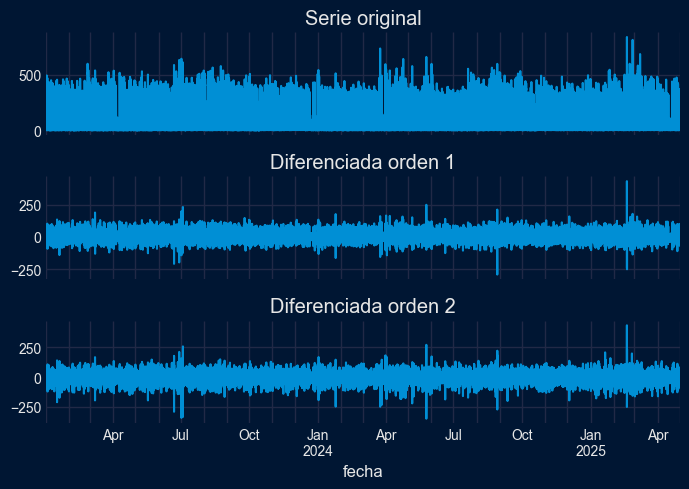

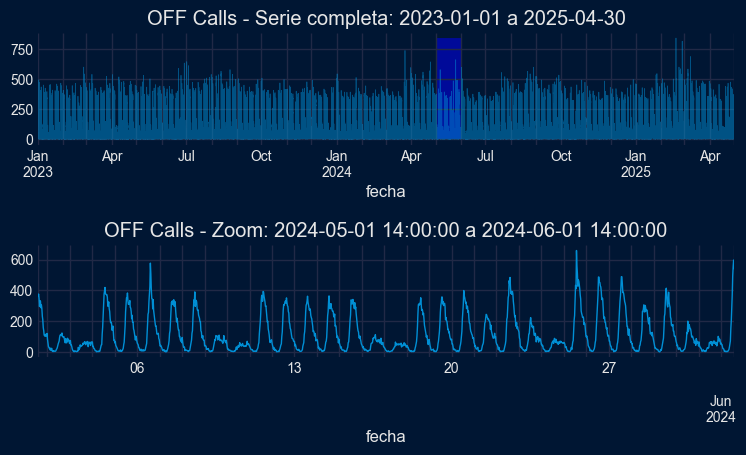

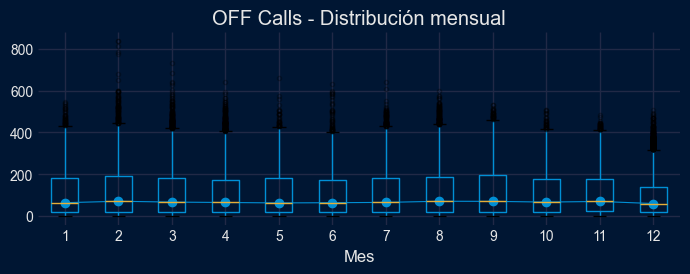

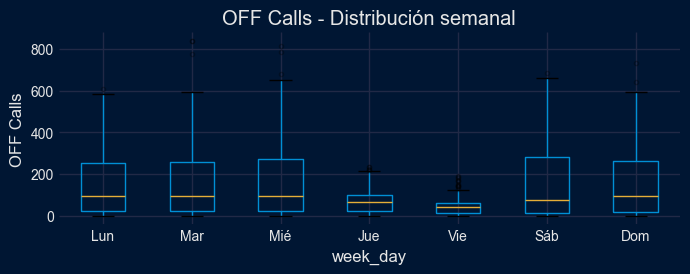

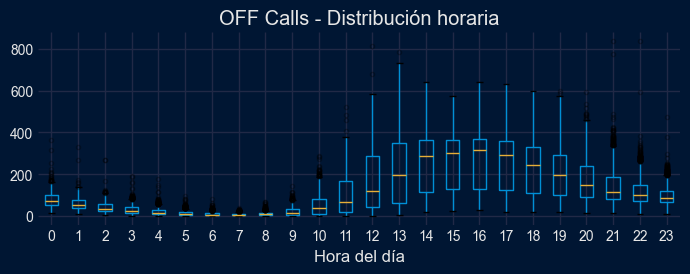

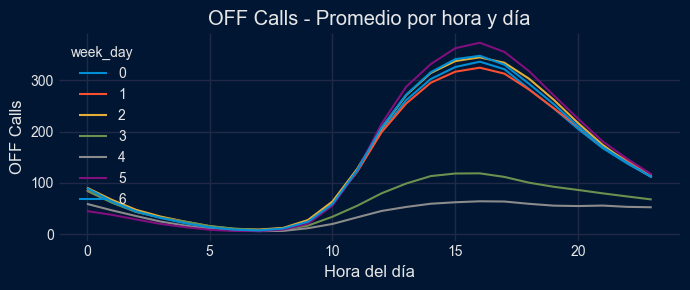

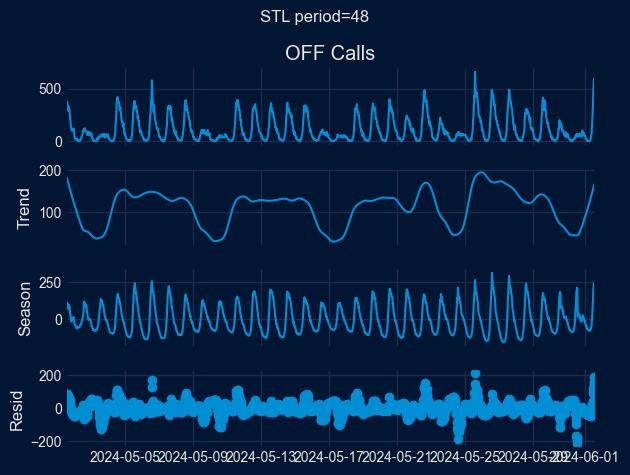

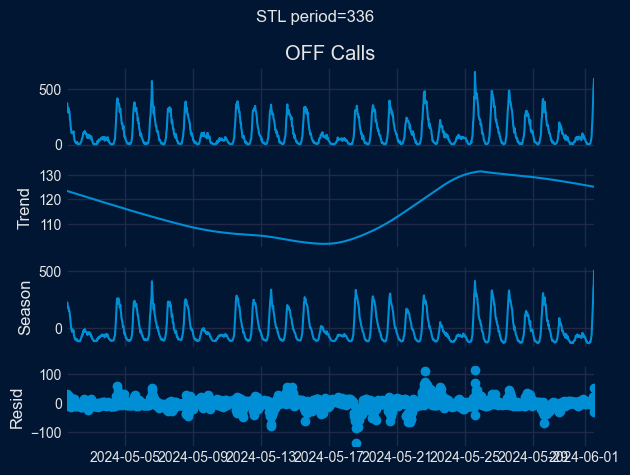


📈 Estacionariedad de 'OFF Calls' entre 2024-05-01 14:00:00 y 2024-06-01 14:00:00
ADF   → Estadístico: -11.1976, p-value: 0.0000 -> Estacionaria
KPSS  → Estadístico: 0.0604, p-value: 0.1000 -> Estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:219: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.




In [ ]:
# Ejemplo de llamada:
train, val, test = dividir_serie_temporal(df, 'OFF Calls', '2024-04-30 23:59:00', '2025-03-31 23:59:00')
fig = graficar_particiones_temporales(train, val, test, 'OFF Calls', '2024-04-30 23:59:00', '2025-03-31 23:59:00')
probar_estacionariedad(df, 'OFF Calls', alpha=0.05)
graficar_con_zoom(df, 'OFF Calls',('2024-05-01 14:00:00', '2024-06-01 14:00:00'))
graficar_boxplots_estacionalidad(df, 'OFF Calls')
res_dict = descomponer_stl(df, 'OFF Calls', [48, 48*7], rango=('2024-05-01 14:00:00', '2024-06-01 14:00:00'))
test_estacionariedad(df, 'OFF Calls', rango=('2024-05-01 14:00:00','2024-06-01 14:00:00'), alpha=0.05)


📊 Handled Calls - Train      : 2023-01-01 00:00:00 — 2024-04-30 23:30:00  (n=23328)
📊 Handled Calls - Validation : 2024-05-01 00:30:00 — 2025-03-31 23:30:00  (n=16079)
📊 Handled Calls - Test       : 2025-04-01 00:30:00 — 2025-04-30 23:30:00  (n=1439)


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.





📈 Serie original:
ADF  → estadístico: -21.4664, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 1.2466, p-valor: 0.0100 -> No estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.





🔁 Diferenciada orden 1:
ADF  → estadístico: -37.8513, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 0.0007, p-valor: 0.1000 -> Estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.





🔁 Diferenciada orden 2:
ADF  → estadístico: -65.3023, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 0.0085, p-valor: 0.1000 -> Estacionaria


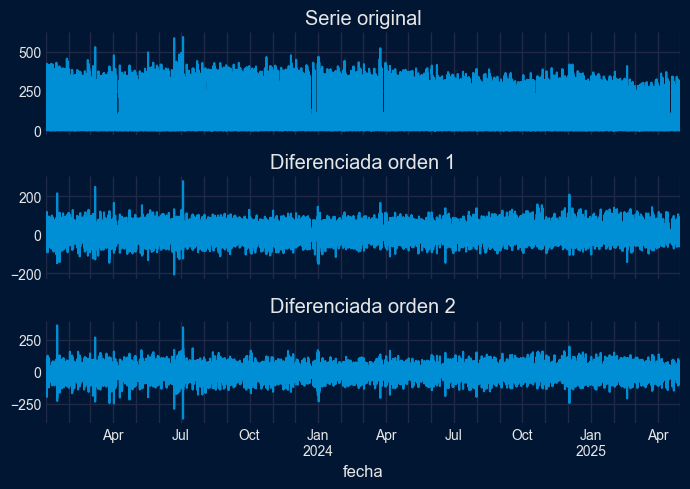

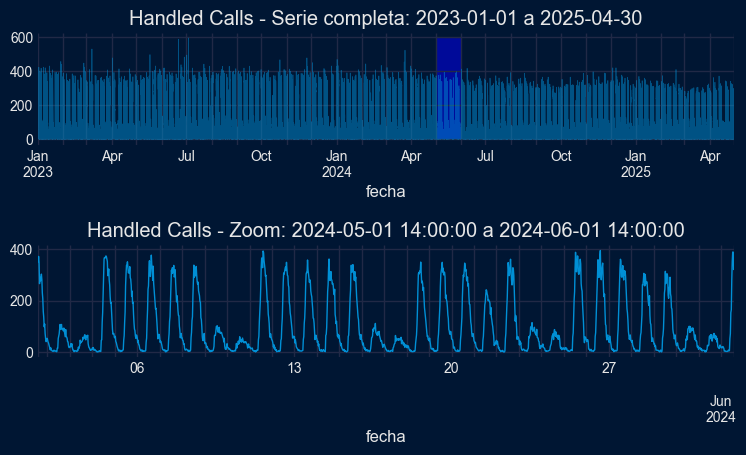

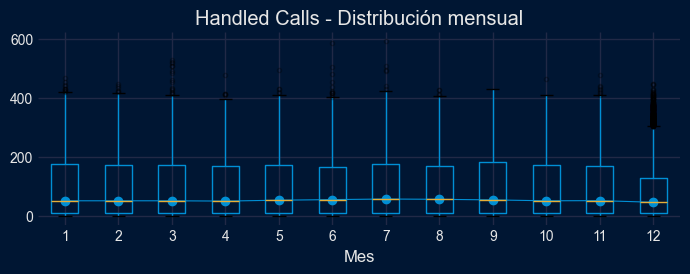

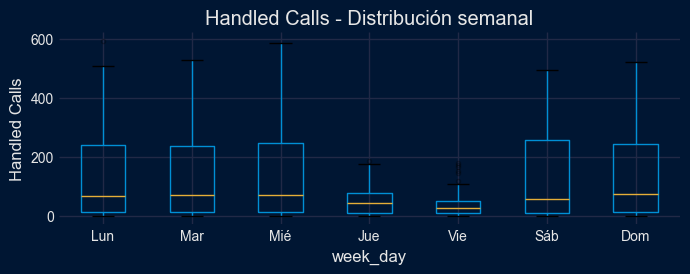

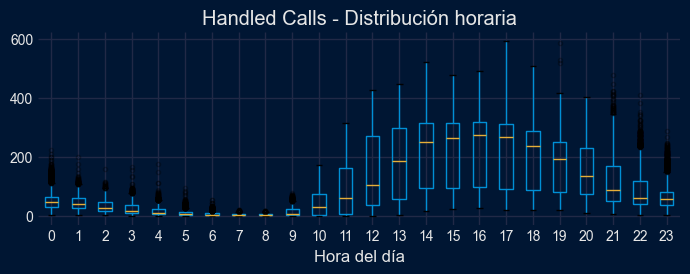

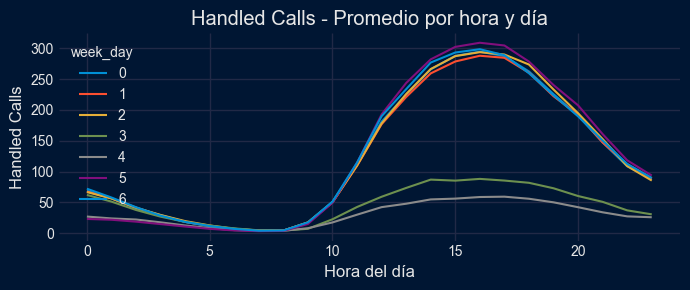

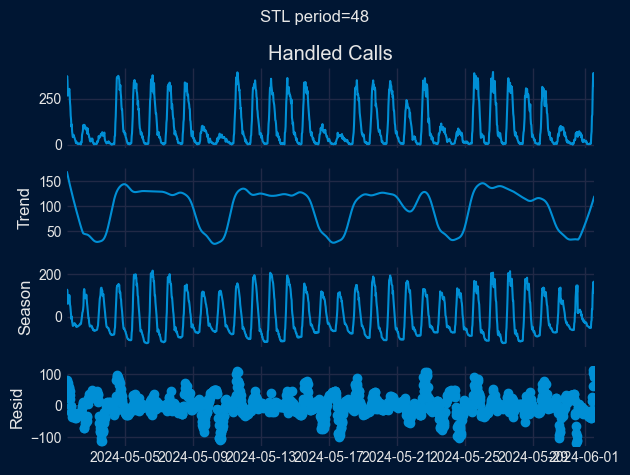

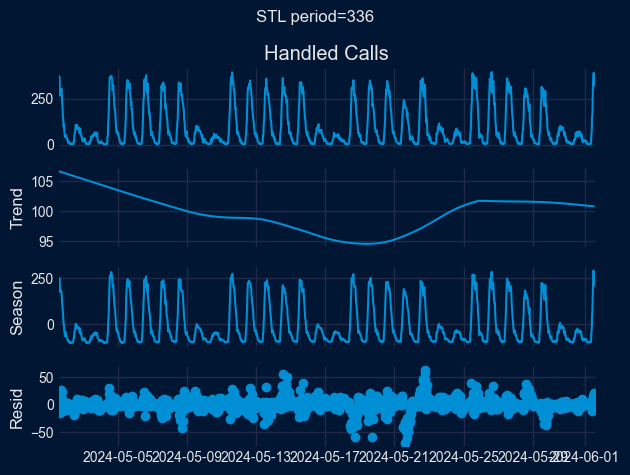


📈 Estacionariedad de 'Handled Calls' entre 2024-05-01 14:00:00 y 2024-06-01 14:00:00
ADF   → Estadístico: -10.4437, p-value: 0.0000 -> Estacionaria
KPSS  → Estadístico: 0.0318, p-value: 0.1000 -> Estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:219: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.




In [ ]:
# Ejemplo de llamada:
train, val, test = dividir_serie_temporal(df, 'Handled Calls', '2024-04-30 23:59:00', '2025-03-31 23:59:00')
fig = graficar_particiones_temporales(train, val, test, 'Handled Calls', '2024-04-30 23:59:00', '2025-03-31 23:59:00')
probar_estacionariedad(df, 'Handled Calls', alpha=0.05)
graficar_con_zoom(df, 'Handled Calls',('2024-05-01 14:00:00', '2024-06-01 14:00:00'))
graficar_boxplots_estacionalidad(df, 'Handled Calls')
res_dict = descomponer_stl(df, 'Handled Calls', [48, 48*7], rango=('2024-05-01 14:00:00', '2024-06-01 14:00:00'))
test_estacionariedad(df, 'Handled Calls', rango=('2024-05-01 14:00:00','2024-06-01 14:00:00'), alpha=0.05)

📊 Real AHT - Train      : 2023-01-01 00:00:00 — 2024-04-30 23:30:00  (n=23328)
📊 Real AHT - Validation : 2024-05-01 00:30:00 — 2025-03-31 23:30:00  (n=16079)
📊 Real AHT - Test       : 2025-04-01 00:30:00 — 2025-04-30 23:30:00  (n=1439)


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.





📈 Serie original:
ADF  → estadístico: -15.7072, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 16.1418, p-valor: 0.0100 -> No estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.





🔁 Diferenciada orden 1:
ADF  → estadístico: -52.8173, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 0.0154, p-valor: 0.1000 -> Estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.





🔁 Diferenciada orden 2:
ADF  → estadístico: -64.9371, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 0.0078, p-valor: 0.1000 -> Estacionaria


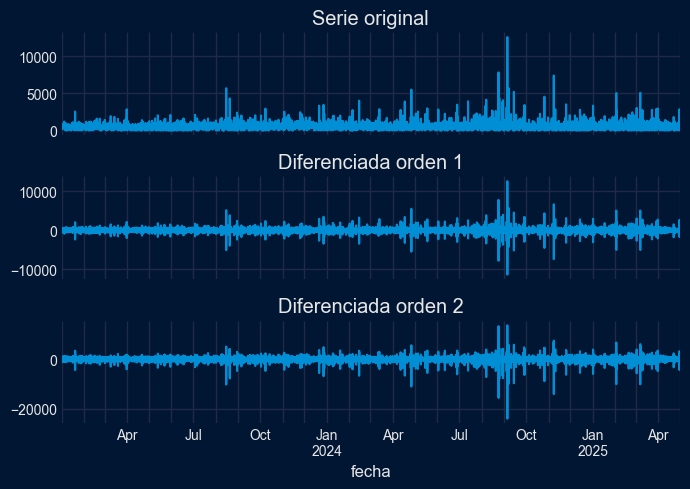

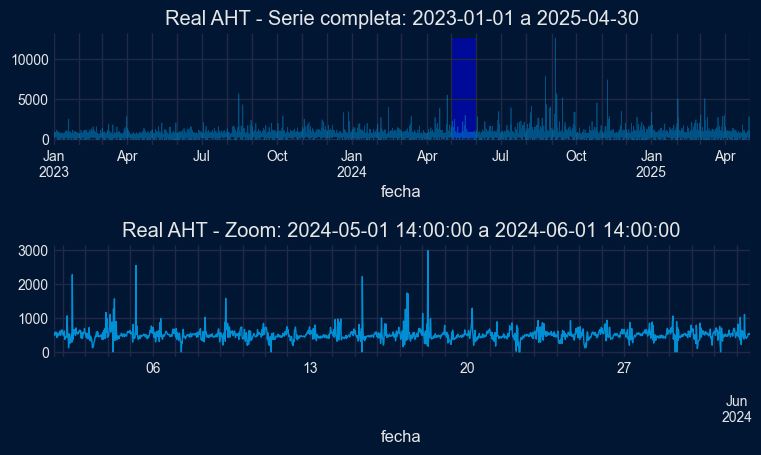

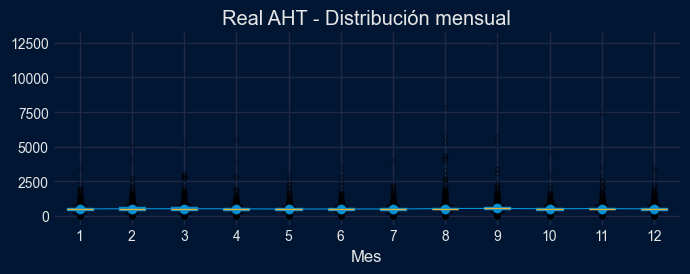

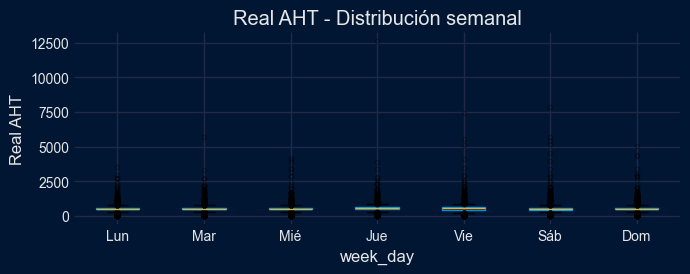

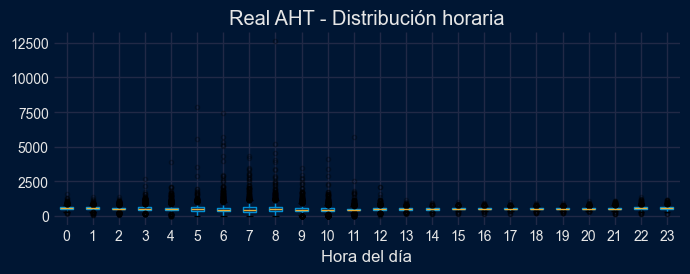

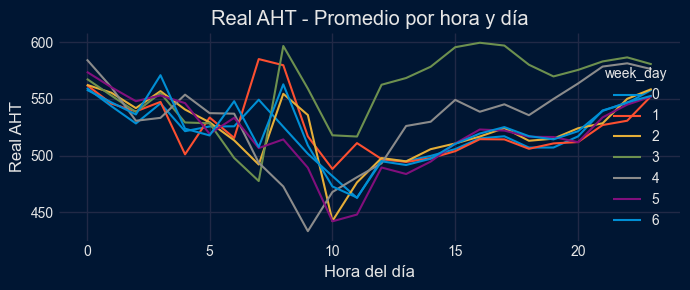

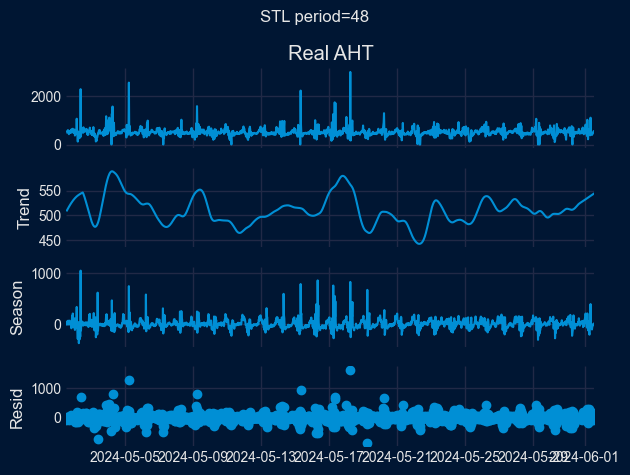

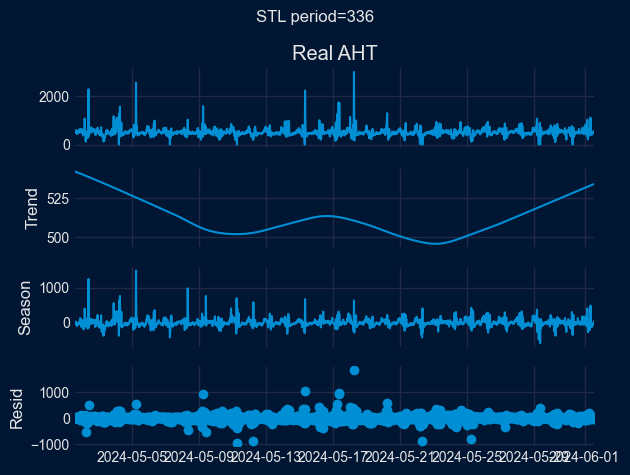


📈 Estacionariedad de 'Real AHT' entre 2024-05-01 14:00:00 y 2024-06-01 14:00:00
ADF   → Estadístico: -12.6434, p-value: 0.0000 -> Estacionaria
KPSS  → Estadístico: 0.1141, p-value: 0.1000 -> Estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:219: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.




In [ ]:
# Ejemplo de llamada:
train, val, test = dividir_serie_temporal(df, 'Real AHT', '2024-04-30 23:59:00', '2025-03-31 23:59:00')
fig = graficar_particiones_temporales(train, val, test, 'Real AHT', '2024-04-30 23:59:00', '2025-03-31 23:59:00')
probar_estacionariedad(df, 'Real AHT', alpha=0.05)
graficar_con_zoom(df, 'Real AHT',('2024-05-01 14:00:00', '2024-06-01 14:00:00'))
graficar_boxplots_estacionalidad(df, 'Real AHT')
res_dict = descomponer_stl(df, 'Real AHT', [48, 48*7], rango=('2024-05-01 14:00:00', '2024-06-01 14:00:00'))
test_estacionariedad(df, 'Real AHT', rango=('2024-05-01 14:00:00','2024-06-01 14:00:00'), alpha=0.05)

📊 Real TSF - Train      : 2023-01-01 00:00:00 — 2024-04-30 23:30:00  (n=23328)
📊 Real TSF - Validation : 2024-05-01 00:30:00 — 2025-03-31 23:30:00  (n=16079)
📊 Real TSF - Test       : 2025-04-01 00:30:00 — 2025-04-30 23:30:00  (n=1439)


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.





📈 Serie original:
ADF  → estadístico: -13.7905, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 13.3509, p-valor: 0.0100 -> No estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.





🔁 Diferenciada orden 1:
ADF  → estadístico: -46.4595, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 0.0887, p-valor: 0.1000 -> Estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.





🔁 Diferenciada orden 2:
ADF  → estadístico: -72.3135, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 0.0047, p-valor: 0.1000 -> Estacionaria


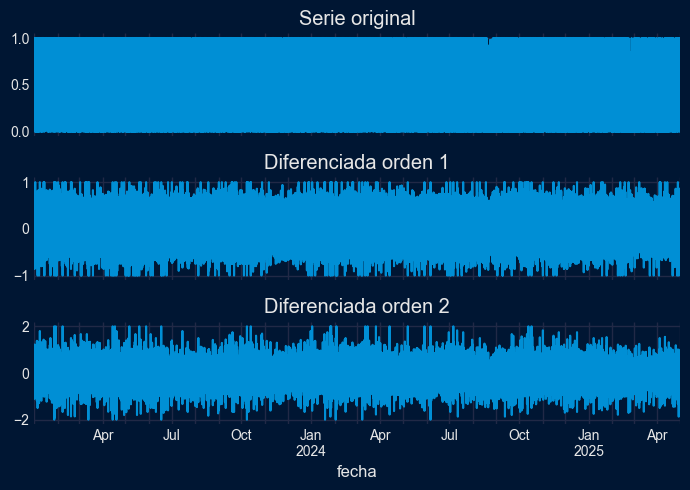

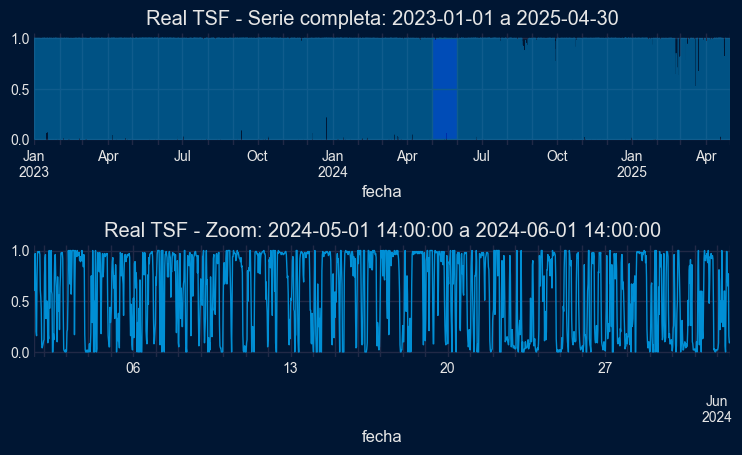

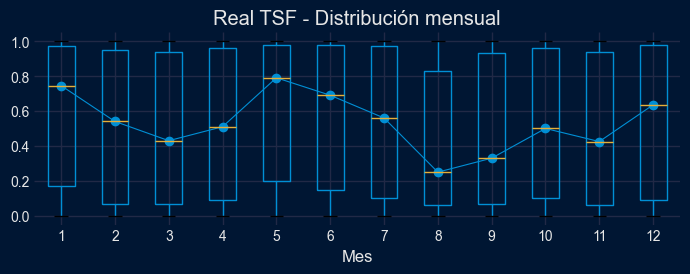

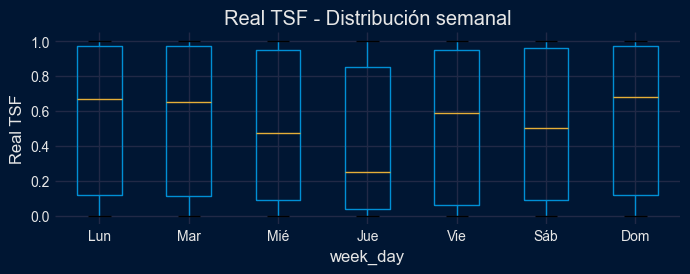

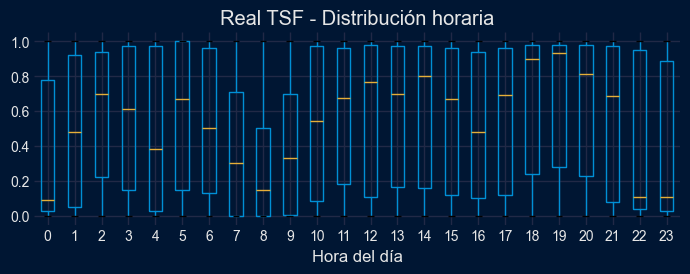

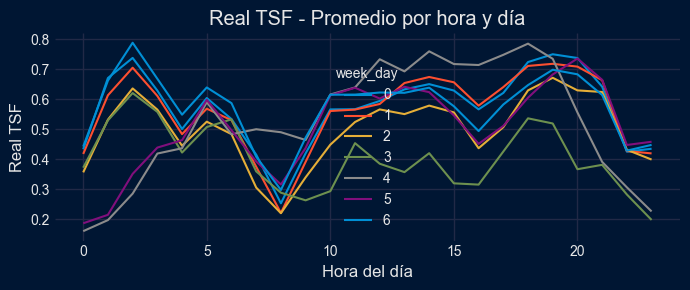

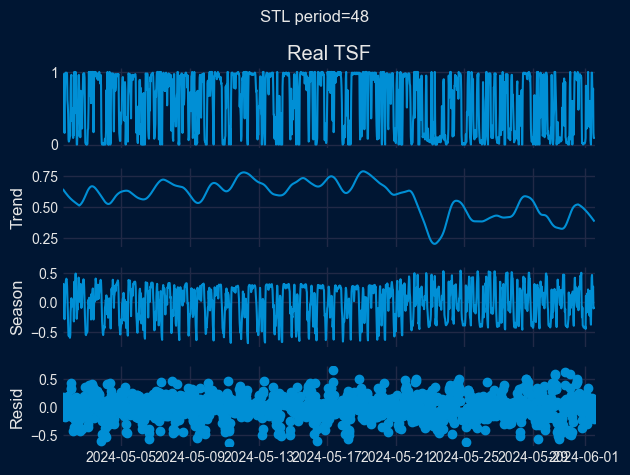

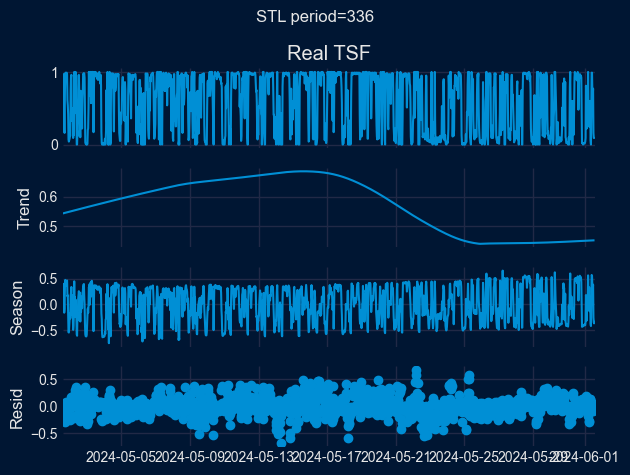


📈 Estacionariedad de 'Real TSF' entre 2024-05-01 14:00:00 y 2024-06-01 14:00:00
ADF   → Estadístico: -15.7218, p-value: 0.0000 -> Estacionaria
KPSS  → Estadístico: 1.2492, p-value: 0.0100 -> No estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:219: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.




In [ ]:
# Ejemplo de llamada:
train, val, test = dividir_serie_temporal(df, 'Real TSF', '2024-04-30 23:59:00', '2025-03-31 23:59:00')
fig = graficar_particiones_temporales(train, val, test, 'Real TSF', '2024-04-30 23:59:00', '2025-03-31 23:59:00')
probar_estacionariedad(df, 'Real TSF', alpha=0.05)
graficar_con_zoom(df, 'Real TSF',('2024-05-01 14:00:00', '2024-06-01 14:00:00'))
graficar_boxplots_estacionalidad(df, 'Real TSF')
res_dict = descomponer_stl(df, 'Real TSF', [48, 48*7], rango=('2024-05-01 14:00:00', '2024-06-01 14:00:00'))
test_estacionariedad(df, 'Real TSF', rango=('2024-05-01 14:00:00','2024-06-01 14:00:00'), alpha=0.05)

📊 Real ABA - Train      : 2023-01-01 00:00:00 — 2024-04-30 23:30:00  (n=23328)
📊 Real ABA - Validation : 2024-05-01 00:30:00 — 2025-03-31 23:30:00  (n=16079)
📊 Real ABA - Test       : 2025-04-01 00:30:00 — 2025-04-30 23:30:00  (n=1439)


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.





📈 Serie original:
ADF  → estadístico: -14.2824, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 8.1026, p-valor: 0.0100 -> No estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.





🔁 Diferenciada orden 1:
ADF  → estadístico: -45.5104, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 0.0068, p-valor: 0.1000 -> Estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.





🔁 Diferenciada orden 2:
ADF  → estadístico: -70.9130, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 0.0123, p-valor: 0.1000 -> Estacionaria


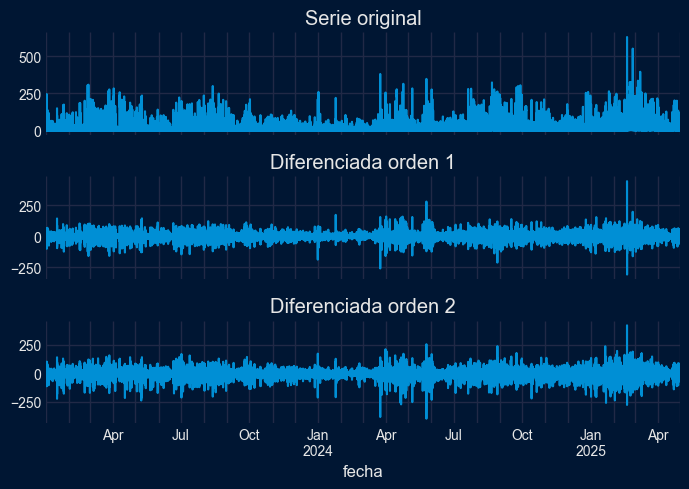

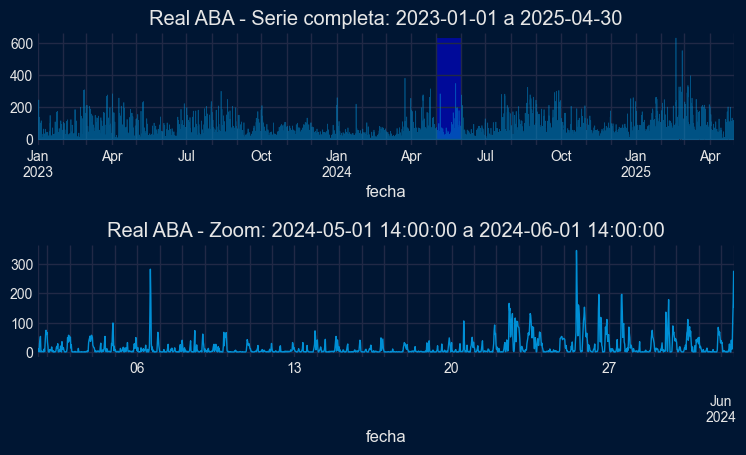

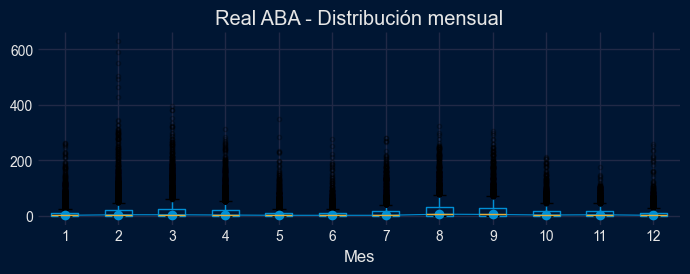

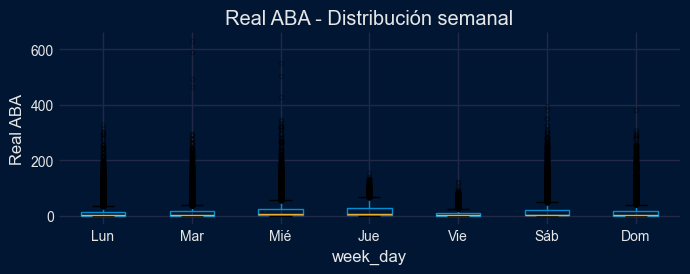

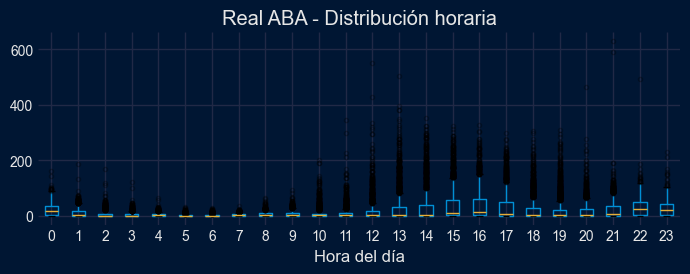

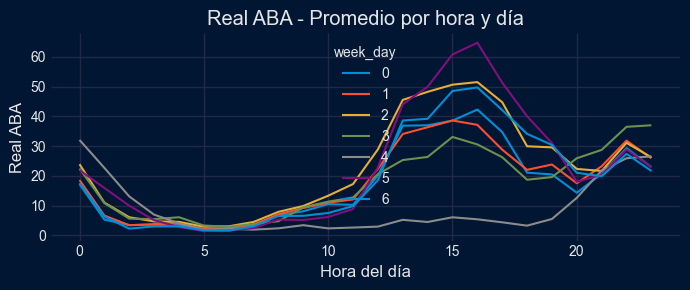

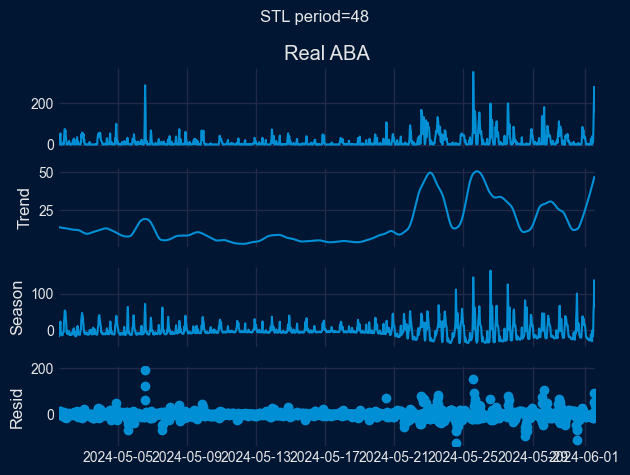

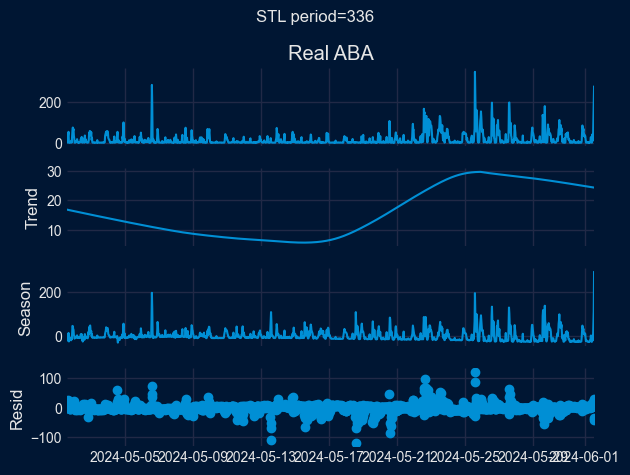


📈 Estacionariedad de 'Real ABA' entre 2024-05-01 14:00:00 y 2024-06-01 14:00:00
ADF   → Estadístico: -6.8494, p-value: 0.0000 -> Estacionaria
KPSS  → Estadístico: 1.5471, p-value: 0.0100 -> No estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:219: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.




In [ ]:
# Ejemplo de llamada:
train, val, test = dividir_serie_temporal(df, 'Real ABA', '2024-04-30 23:59:00', '2025-03-31 23:59:00')
fig = graficar_particiones_temporales(train, val, test, 'Real ABA', '2024-04-30 23:59:00', '2025-03-31 23:59:00')
probar_estacionariedad(df, 'Real ABA', alpha=0.05)
graficar_con_zoom(df, 'Real ABA',('2024-05-01 14:00:00', '2024-06-01 14:00:00'))
graficar_boxplots_estacionalidad(df, 'Real ABA')
res_dict = descomponer_stl(df, 'Real ABA', [48, 48*7], rango=('2024-05-01 14:00:00', '2024-06-01 14:00:00'))
test_estacionariedad(df, 'Real ABA', rango=('2024-05-01 14:00:00','2024-06-01 14:00:00'), alpha=0.05)

📊 Real ASA - Train      : 2023-01-01 00:00:00 — 2024-04-30 23:30:00  (n=23328)
📊 Real ASA - Validation : 2024-05-01 00:30:00 — 2025-03-31 23:30:00  (n=16079)
📊 Real ASA - Test       : 2025-04-01 00:30:00 — 2025-04-30 23:30:00  (n=1439)


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.





📈 Serie original:
ADF  → estadístico: -13.7875, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 12.2785, p-valor: 0.0100 -> No estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.





🔁 Diferenciada orden 1:
ADF  → estadístico: -49.3871, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 0.0078, p-valor: 0.1000 -> Estacionaria


C:\Users\nicol\AppData\Local\Temp\ipykernel_23372\2925663447.py:73: InterpolationWarning:

The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.





🔁 Diferenciada orden 2:
ADF  → estadístico: -72.0775, p-valor: 0.0000 -> Estacionaria
KPSS → estadístico: 0.0058, p-valor: 0.1000 -> Estacionaria


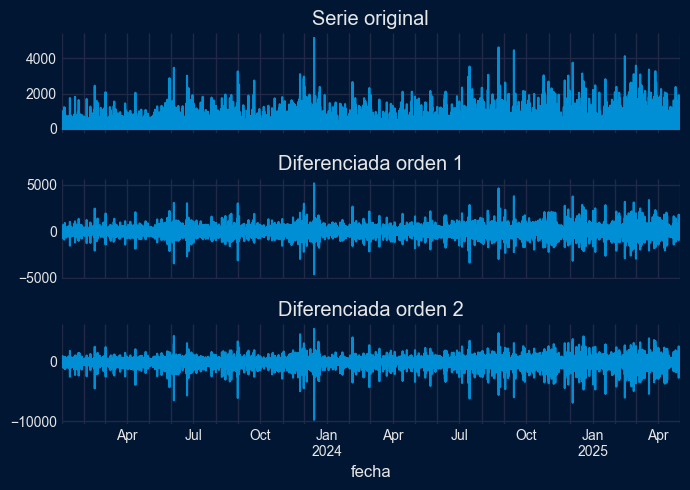

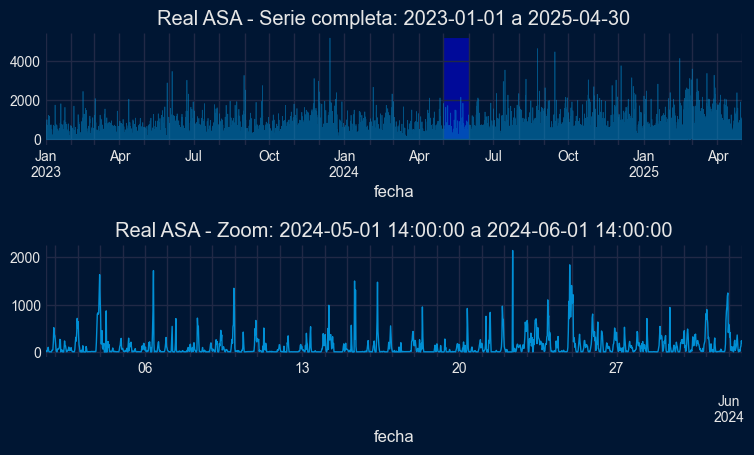

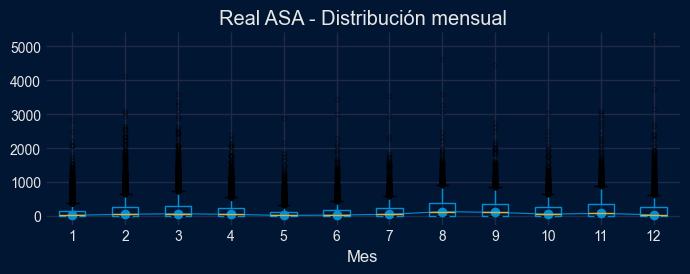

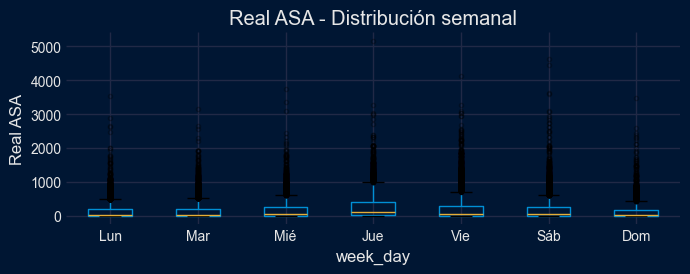

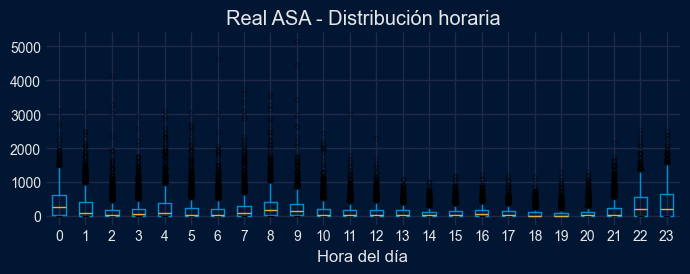

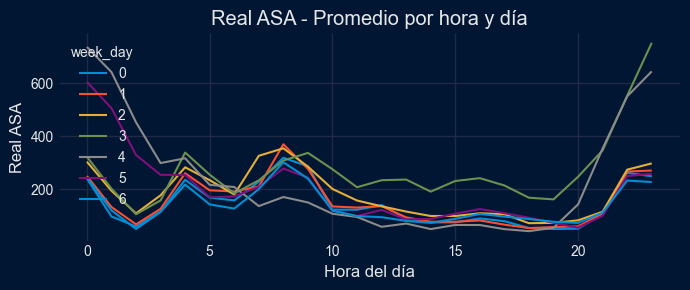

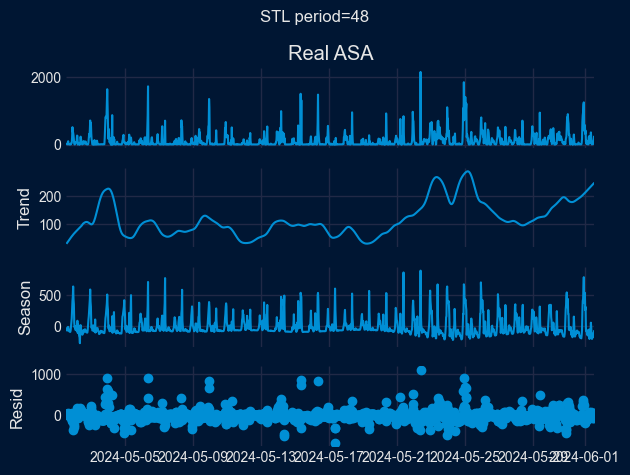

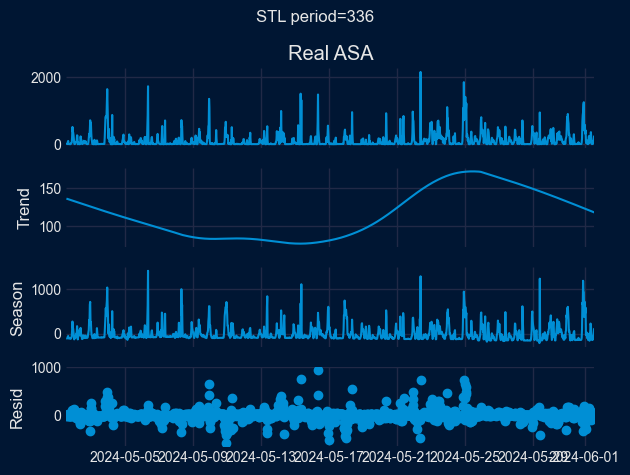


📈 Estacionariedad de 'Real ASA' entre 2024-05-01 14:00:00 y 2024-06-01 14:00:00
ADF   → Estadístico: -14.4382, p-value: 0.0000 -> Estacionaria
KPSS  → Estadístico: 0.6952, p-value: 0.0140 -> No estacionaria


In [ ]:
# Ejemplo de llamada:
train, val, test = dividir_serie_temporal(df, 'Real ASA', '2024-04-30 23:59:00', '2025-03-31 23:59:00')
fig = graficar_particiones_temporales(train, val, test, 'Real ASA', '2024-04-30 23:59:00', '2025-03-31 23:59:00')
probar_estacionariedad(df, 'Real ASA', alpha=0.05)
graficar_con_zoom(df, 'Real ASA',('2024-05-01 14:00:00', '2024-06-01 14:00:00'))
graficar_boxplots_estacionalidad(df, 'Real ASA')
res_dict = descomponer_stl(df, 'Real ASA', [48, 48*7], rango=('2024-05-01 14:00:00', '2024-06-01 14:00:00'))
test_estacionariedad(df, 'Real ASA', rango=('2024-05-01 14:00:00','2024-06-01 14:00:00'), alpha=0.05)

In [ ]:
df.head()

,OFF Calls,Handled Calls,Real AHT,Real TSF,Real ABA,Real ASA
fecha,,,,,,
2023-01-01 00:00:00,57,57,558,0.98,0,1
2023-01-01 00:30:00,53,53,509,0.98,0,1
2023-01-01 01:00:00,48,48,609,1.00,0,1
2023-01-01 01:30:00,40,40,587,0.98,0,1
2023-01-01 02:00:00,48,47,515,0.96,1,2


#### 2. Autocorrelacion y autocorrealcion parcial de targets

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import warnings
from statsmodels.tsa.stattools import adfuller, kpss, acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import STL
import plotly.graph_objects as go
from skforecast.plot import set_dark_theme
from matplotlib.gridspec import GridSpec

# ==== División de serie temporal sin solapamientos ====
# ... (funciones previas mantendrían su lugar)


# ==== Autocorrelación y Autocorrelación Parcial ====
def plot_autocorrelation(data, columna_objetivo, orden_diff=0, lags=120, figsize=(5, 2)):
    """
    Grafica la función de autocorrelación (ACF) para `columna_objetivo`,
    opcionalmente diferenciada `orden_diff` veces.
    """
    serie = data[columna_objetivo].dropna()
    if orden_diff > 0:
        serie = serie.diff(periods=orden_diff).dropna()

    fig, ax = plt.subplots(figsize=figsize)
    plot_acf(serie, ax=ax, lags=lags)
    ax.set_title(f"ACF - {columna_objetivo} (diff={orden_diff})")
    plt.tight_layout()
    plt.show()
    return fig


def plot_partial_autocorrelation(data, columna_objetivo, orden_diff=0, lags=120, figsize=(5, 2)):
    """
    Grafica la función de autocorrelación parcial (PACF) para `columna_objetivo`,
    opcionalmente diferenciada `orden_diff` veces.
    """
    serie = data[columna_objetivo].dropna()
    if orden_diff > 0:
        serie = serie.diff(periods=orden_diff).dropna()

    fig, ax = plt.subplots(figsize=figsize)
    plot_pacf(serie, ax=ax, lags=lags, method='ywm')
    ax.set_title(f"PACF - {columna_objetivo} (diff={orden_diff})")
    plt.tight_layout()
    plt.show()
    return fig


def calcular_lag_autocorrelaciones(
    serie: pd.Series,
    n_lags: int = 120,
    orden_diff: int = 0,
    sort_by: str = "partial_autocorrelation_abs"
) -> pd.DataFrame:
    """
    Calcula ACF y PACF de `serie` con `n_lags`, tras diferenciar `orden_diff` veces.

    Retorna DataFrame ordenado según `sort_by`.
    """
    if not isinstance(serie, pd.Series):
        raise ValueError("La entrada 'serie' debe ser una pd.Series")

    s = serie.dropna()
    if orden_diff > 0:
        s = s.diff(periods=orden_diff).dropna()

    acf_vals = acf(s, nlags=n_lags)
    pacf_vals = pacf(s, nlags=n_lags, method='ywm')

    df_lags = pd.DataFrame({
        "lag": range(len(acf_vals)),
        "autocorrelation": acf_vals,
        "partial_autocorrelation": pacf_vals
    })
    df_lags["autocorrelation_abs"] = df_lags["autocorrelation"].abs()
    df_lags["partial_autocorrelation_abs"] = df_lags["partial_autocorrelation"].abs()
    df_lags = df_lags[df_lags["lag"] > 0]

    if sort_by in df_lags.columns:
        df_lags = df_lags.sort_values(by=sort_by, ascending=False)

    return df_lags.reset_index(drop=True)



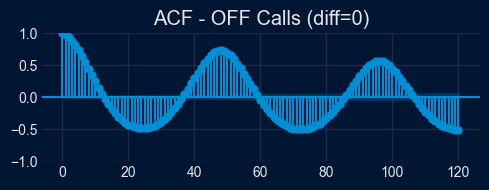

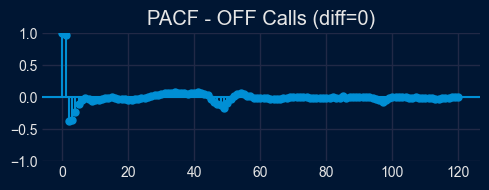

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    1         0.978011                 0.978011             0.978011   
1    2         0.940638                -0.364805             0.940638   
2    3         0.885356                -0.355871             0.885356   
3    4         0.814729                -0.234468             0.814729   
4   49         0.728260                -0.168760             0.728260   
5   48         0.739697                -0.121458             0.739697   
6   47         0.730885                -0.112871             0.730885   
7    5         0.732746                -0.101139             0.732746   
8   50         0.698833                -0.086153             0.698833   
9   34        -0.173845                 0.079943             0.173845   

   partial_autocorrelation_abs  
0                     0.978011  
1                     0.364805  
2                     0.355871  
3                     0.234468  
4                     0.168760 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'OFF Calls', orden_diff=0, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'OFF Calls', orden_diff=0, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['OFF Calls'], n_lags=120, orden_diff=0, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))


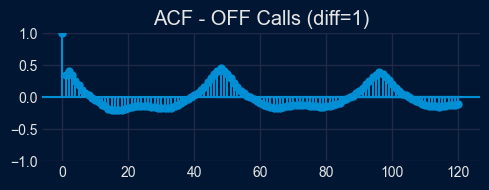

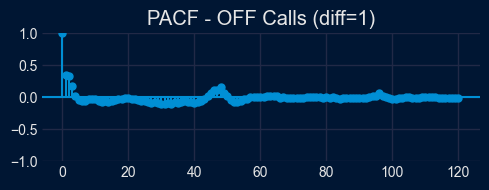

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    1         0.349856                 0.349856             0.349856   
1    2         0.407313                 0.324651             0.407313   
2    3         0.348994                 0.177270             0.348994   
3   48         0.460412                 0.158755             0.460412   
4   47         0.409442                 0.114090             0.409442   
5   46         0.369692                 0.106874             0.369692   
6   30        -0.172861                -0.105554             0.172861   
7   31        -0.170802                -0.099225             0.170802   
8   33        -0.165165                -0.098907             0.165165   
9   32        -0.167936                -0.094479             0.167936   

   partial_autocorrelation_abs  
0                     0.349856  
1                     0.324651  
2                     0.177270  
3                     0.158755  
4                     0.114090 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'OFF Calls', orden_diff=1, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'OFF Calls', orden_diff=1, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['OFF Calls'], n_lags=120, orden_diff=1, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

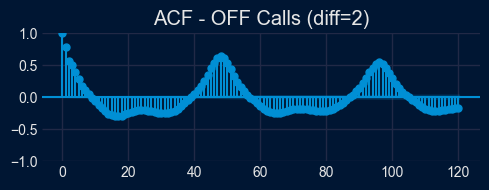

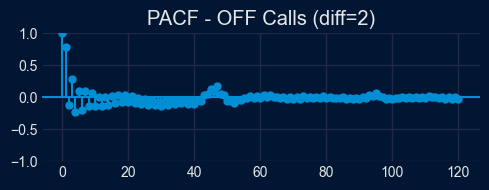

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    1         0.780463                 0.780463             0.780463   
1    3         0.505086                 0.286130             0.505086   
2    4         0.390306                -0.237055             0.390306   
3    6         0.182185                -0.198010             0.182185   
4   47         0.610800                 0.177505             0.610800   
5   10        -0.063707                -0.142487             0.063707   
6   12        -0.172934                -0.138165             0.172934   
7    8         0.045845                -0.136224             0.045845   
8   30        -0.251344                -0.130399             0.251344   
9   32        -0.248850                -0.127971             0.248850   

   partial_autocorrelation_abs  
0                     0.780463  
1                     0.286130  
2                     0.237055  
3                     0.198010  
4                     0.177505 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'OFF Calls', orden_diff=2, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'OFF Calls', orden_diff=2, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['OFF Calls'], n_lags=120, orden_diff=2, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

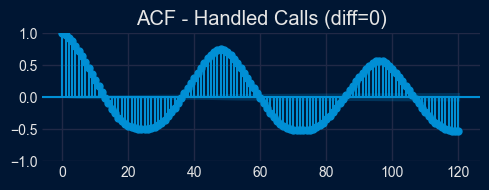

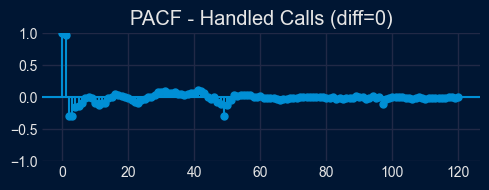

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    1         0.973890                 0.973890             0.973890   
1    2         0.933133                -0.297426             0.933133   
2   49         0.743160                -0.295422             0.743160   
3    3         0.875848                -0.288469             0.875848   
4    4         0.806576                -0.153297             0.806576   
5    5         0.726446                -0.132642             0.726446   
6   11         0.177465                -0.119711             0.177465   
7   50         0.710768                -0.118299             0.710768   
8   97         0.561009                -0.109922             0.561009   
9   41         0.385492                 0.109206             0.385492   

   partial_autocorrelation_abs  
0                     0.973890  
1                     0.297426  
2                     0.295422  
3                     0.288469  
4                     0.153297 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Handled Calls', orden_diff=0, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Handled Calls', orden_diff=0, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Handled Calls'], n_lags=120, orden_diff=0, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

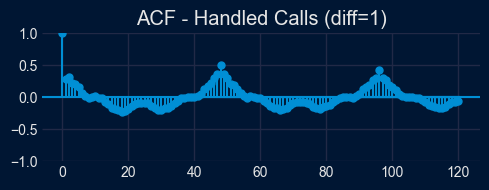

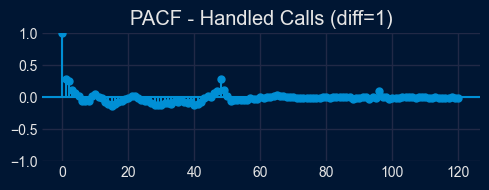

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0   48         0.508612                 0.287333             0.508612   
1    1         0.280563                 0.280563             0.280563   
2    2         0.316594                 0.258202             0.316594   
3   15        -0.162858                -0.131679             0.162858   
4   28        -0.172627                -0.125827             0.172627   
5   30        -0.204403                -0.124323             0.204403   
6   29        -0.192149                -0.123122             0.192149   
7   40        -0.003471                -0.115798             0.003471   
8    3         0.229547                 0.106081             0.229547   
9   49         0.356789                 0.105457             0.356789   

   partial_autocorrelation_abs  
0                     0.287333  
1                     0.280563  
2                     0.258202  
3                     0.131679  
4                     0.125827 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Handled Calls', orden_diff=1, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Handled Calls', orden_diff=1, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Handled Calls'], n_lags=120, orden_diff=1, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

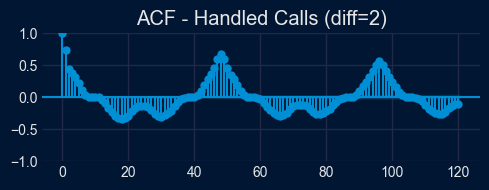

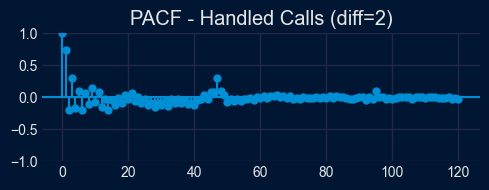

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    1         0.733160                 0.733160             0.733160   
1    3         0.384079                 0.307658             0.384079   
2   47         0.596416                 0.302609             0.596416   
3    6         0.119765                -0.207233             0.119765   
4    2         0.446404                -0.197025             0.446404   
5   14        -0.168930                -0.192859             0.168930   
6    4         0.311992                -0.162607             0.311992   
7   28        -0.260380                -0.155665             0.260380   
8   12        -0.037742                -0.151089             0.037742   
9    9         0.002712                 0.146164             0.002712   

   partial_autocorrelation_abs  
0                     0.733160  
1                     0.307658  
2                     0.302609  
3                     0.207233  
4                     0.197025 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Handled Calls', orden_diff=2, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Handled Calls', orden_diff=2, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Handled Calls'], n_lags=120, orden_diff=2, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

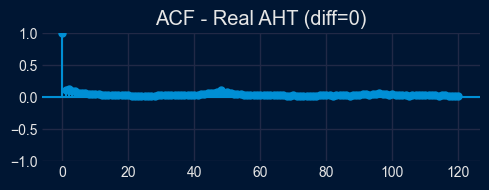

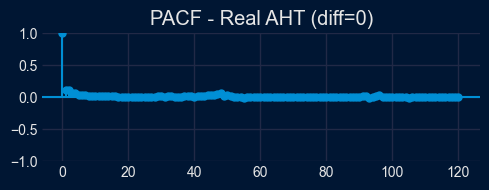

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    1         0.118623                 0.118623             0.118623   
1    2         0.130495                 0.118085             0.130495   
2    4         0.098155                 0.068757             0.098155   
3    3         0.093850                 0.068084             0.093850   
4   48         0.107428                 0.065872             0.107428   
5   47         0.086051                 0.048799             0.086051   
6   46         0.071467                 0.036821             0.071467   
7   50         0.085703                 0.035638             0.085703   
8    5         0.069004                 0.035419             0.069004   
9   96         0.074019                 0.033099             0.074019   

   partial_autocorrelation_abs  
0                     0.118623  
1                     0.118085  
2                     0.068757  
3                     0.068084  
4                     0.065872 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Real AHT', orden_diff=0, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Real AHT', orden_diff=0, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Real AHT'], n_lags=120, orden_diff=0, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

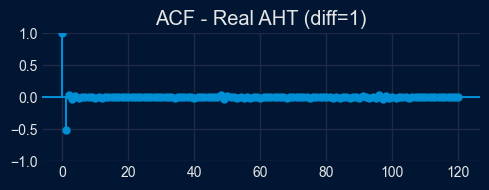

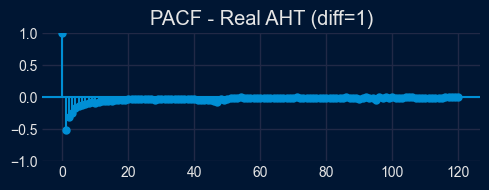

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    1        -0.506734                -0.506734             0.506734   
1    2         0.027521                -0.308466             0.027521   
2    3        -0.023229                -0.239837             0.023229   
3    4         0.018978                -0.168518             0.018978   
4    5        -0.014871                -0.143193             0.014871   
5    6         0.002214                -0.121822             0.002214   
6    7        -0.001657                -0.106236             0.001657   
7    8        -0.001277                -0.096472             0.001277   
8   10        -0.009188                -0.082817             0.009188   
9    9         0.004228                -0.080043             0.004228   

   partial_autocorrelation_abs  
0                     0.506734  
1                     0.308466  
2                     0.239837  
3                     0.168518  
4                     0.143193 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Real AHT', orden_diff=1, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Real AHT', orden_diff=1, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Real AHT'], n_lags=120, orden_diff=1, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

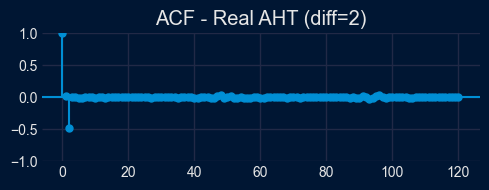

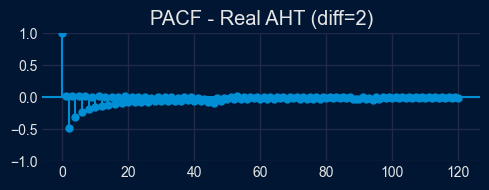

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    2        -0.481405                -0.481705             0.481405   
1    4        -0.000141                -0.303065             0.000141   
2    6        -0.012270                -0.227336             0.012270   
3    8         0.000019                -0.178418             0.000019   
4   10        -0.004567                -0.151004             0.004567   
5   12         0.000903                -0.129392             0.000903   
6   14        -0.002671                -0.116354             0.002671   
7   16         0.003755                -0.099187             0.003755   
8   46        -0.013465                -0.094431             0.013465   
9   18        -0.002122                -0.089233             0.002122   

   partial_autocorrelation_abs  
0                     0.481705  
1                     0.303065  
2                     0.227336  
3                     0.178418  
4                     0.151004 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Real AHT', orden_diff=2, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Real AHT', orden_diff=2, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Real AHT'], n_lags=120, orden_diff=2, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

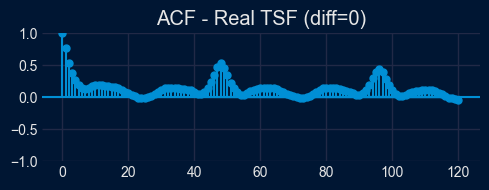

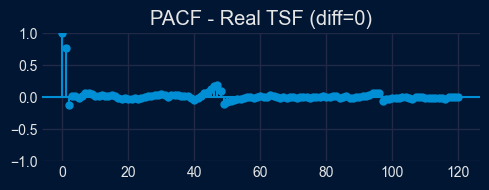

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    1         0.764920                 0.764920             0.764920   
1   47         0.467614                 0.197805             0.467614   
2   46         0.347899                 0.181897             0.347899   
3   45         0.233746                 0.130931             0.233746   
4    2         0.537707                -0.114232             0.537707   
5   49         0.463845                -0.108727             0.463845   
6   48         0.529950                 0.102111             0.529950   
7   44         0.146710                 0.085512             0.146710   
8   94         0.297691                 0.073226             0.297691   
9   50         0.345659                -0.072276             0.345659   

   partial_autocorrelation_abs  
0                     0.764920  
1                     0.197805  
2                     0.181897  
3                     0.130931  
4                     0.114232 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Real TSF', orden_diff=0, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Real TSF', orden_diff=0, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Real TSF'], n_lags=120, orden_diff=0, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

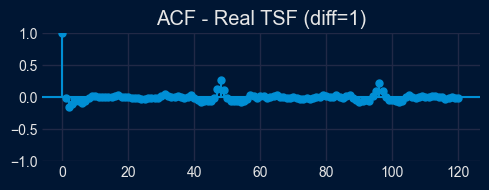

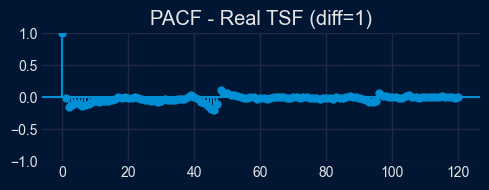

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0   46        -0.011833                -0.201307             0.011833   
1   45        -0.057684                -0.187097             0.057684   
2    2        -0.148642                -0.148964             0.148642   
3    6        -0.088051                -0.140102             0.088051   
4   44        -0.056850                -0.138171             0.056850   
5    7        -0.055623                -0.121900             0.055623   
6    3        -0.112227                -0.120281             0.112227   
7    8        -0.019339                -0.107689             0.019339   
8   48         0.273221                 0.106147             0.273221   
9   47         0.122036                -0.104717             0.122036   

   partial_autocorrelation_abs  
0                     0.201307  
1                     0.187097  
2                     0.148964  
3                     0.140102  
4                     0.138171 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Real TSF', orden_diff=1, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Real TSF', orden_diff=1, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Real TSF'], n_lags=120, orden_diff=1, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

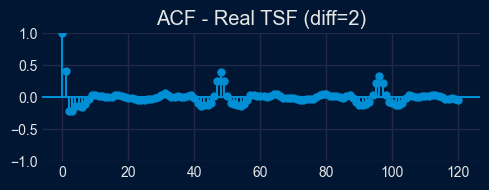

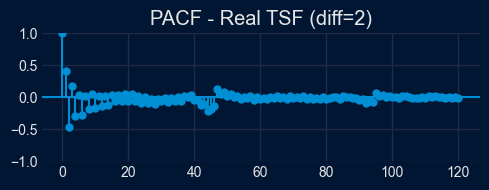

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    2        -0.216752                -0.471240             0.216752   
1    1         0.415903                 0.415903             0.415903   
2    4        -0.142806                -0.299817             0.142806   
3    6        -0.145656                -0.270443             0.145656   
4   44        -0.117016                -0.210780             0.117016   
5    8        -0.035402                -0.188084             0.035402   
6   45        -0.093592                -0.177810             0.093592   
7    3        -0.218682                 0.170877             0.218682   
8   10         0.041487                -0.164156             0.041487   
9   12         0.013533                -0.130964             0.013533   

   partial_autocorrelation_abs  
0                     0.471240  
1                     0.415903  
2                     0.299817  
3                     0.270443  
4                     0.210780 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Real TSF', orden_diff=2, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Real TSF', orden_diff=2, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Real TSF'], n_lags=120, orden_diff=2, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

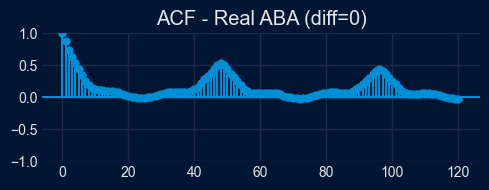

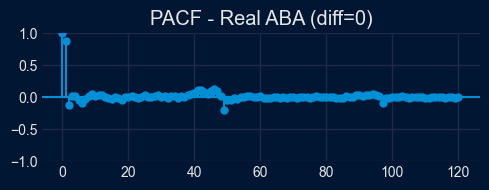

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    1         0.875990                 0.875990             0.875990   
1   49         0.501781                -0.200195             0.501781   
2   46         0.448534                 0.127900             0.448534   
3    2         0.737909                -0.126585             0.737909   
4   41         0.165880                 0.108453             0.165880   
5   42         0.221390                 0.108182             0.221390   
6   47         0.508746                 0.100179             0.508746   
7   45         0.386138                 0.098615             0.386138   
8    6         0.351593                -0.097389             0.351593   
9   97         0.408653                -0.090118             0.408653   

   partial_autocorrelation_abs  
0                     0.875990  
1                     0.200195  
2                     0.127900  
3                     0.126585  
4                     0.108453 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Real ABA', orden_diff=0, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Real ABA', orden_diff=0, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Real ABA'], n_lags=120, orden_diff=0, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

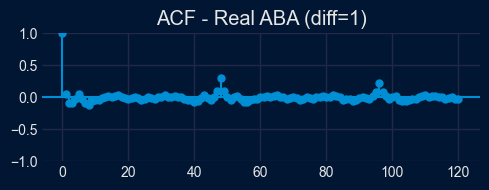

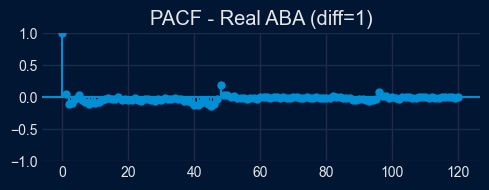

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0   48         0.304298                 0.196919             0.304298   
1   45        -0.035741                -0.131957             0.035741   
2   40        -0.070911                -0.119102             0.070911   
3   41        -0.060318                -0.116657             0.060318   
4    8        -0.117134                -0.112081             0.117134   
5   44        -0.007904                -0.103805             0.007904   
6   46         0.008781                -0.103372             0.008781   
7    2        -0.094849                -0.098386             0.094849   
8   96         0.227074                 0.087702             0.227074   
9   42        -0.016773                -0.086997             0.016773   

   partial_autocorrelation_abs  
0                     0.196919  
1                     0.131957  
2                     0.119102  
3                     0.116657  
4                     0.112081 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Real ABA', orden_diff=1, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Real ABA', orden_diff=1, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Real ABA'], n_lags=120, orden_diff=1, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

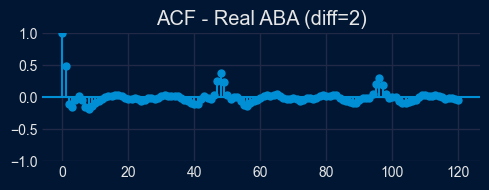

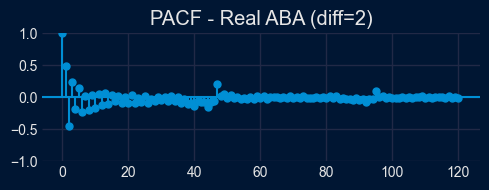

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    1         0.481972                 0.481972             0.481972   
1    2        -0.108489                -0.443904             0.108489   
2    3        -0.147056                 0.230999             0.147056   
3    6        -0.041746                -0.229041             0.041746   
4   47         0.247178                 0.214869             0.247178   
5    8        -0.178056                -0.194459             0.178056   
6    4        -0.046064                -0.180932             0.046064   
7   10        -0.087897                -0.172705             0.087897   
8   44        -0.009004                -0.155402             0.009004   
9    5         0.019990                 0.144619             0.019990   

   partial_autocorrelation_abs  
0                     0.481972  
1                     0.443904  
2                     0.230999  
3                     0.229041  
4                     0.214869 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Real ABA', orden_diff=2, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Real ABA', orden_diff=2, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Real ABA'], n_lags=120, orden_diff=2, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

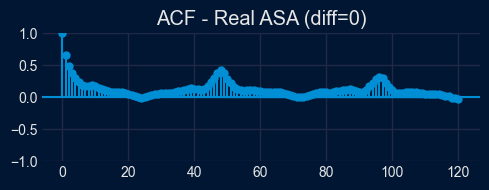

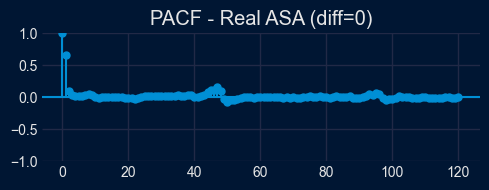

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    1         0.657053                 0.657053             0.657053   
1   47         0.381940                 0.166281             0.381940   
2   46         0.297102                 0.118599             0.297102   
3   45         0.232502                 0.111233             0.232502   
4    2         0.491058                 0.104420             0.491058   
5   48         0.419852                 0.096784             0.419852   
6   44         0.172011                 0.079943             0.172011   
7   50         0.291896                -0.078507             0.291896   
8   95         0.286349                 0.063071             0.286349   
9   96         0.323716                 0.056750             0.323716   

   partial_autocorrelation_abs  
0                     0.657053  
1                     0.166281  
2                     0.118599  
3                     0.111233  
4                     0.104420 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Real ASA', orden_diff=0, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Real ASA', orden_diff=0, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Real ASA'], n_lags=120, orden_diff=0, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

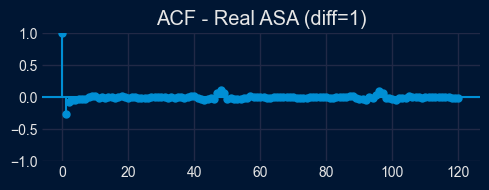

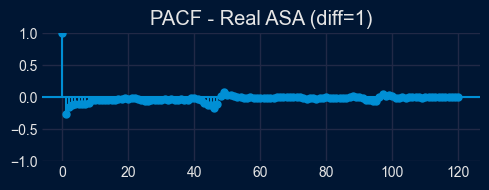

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    1        -0.257978                -0.257978             0.257978   
1   46        -0.029497                -0.170613             0.029497   
2    2        -0.074618                -0.151236             0.074618   
3   45        -0.006045                -0.124516             0.006045   
4    3        -0.047674                -0.119341             0.047674   
5   44        -0.030933                -0.118701             0.030933   
6    7        -0.026676                -0.109171             0.026676   
7    4        -0.036370                -0.106890             0.036370   
8    6        -0.029148                -0.103664             0.029148   
9   47         0.068374                -0.100134             0.068374   

   partial_autocorrelation_abs  
0                     0.257978  
1                     0.170613  
2                     0.151236  
3                     0.124516  
4                     0.119341 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Real ASA', orden_diff=1, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Real ASA', orden_diff=1, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Real ASA'], n_lags=120, orden_diff=1, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

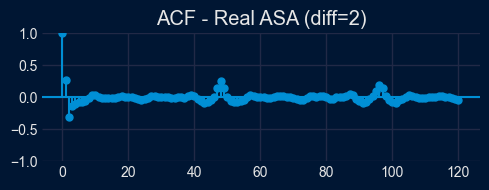

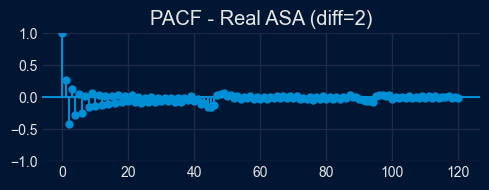

   lag  autocorrelation  partial_autocorrelation  autocorrelation_abs  \
0    2        -0.306516                -0.414161             0.306516   
1    4        -0.100080                -0.284766             0.100080   
2    1         0.275897                 0.275897             0.275897   
3    6        -0.076194                -0.243204             0.076194   
4    8        -0.005316                -0.159771             0.005316   
5   45        -0.048850                -0.148055             0.048850   
6   44        -0.071968                -0.146688             0.071968   
7   10         0.027447                -0.137499             0.027447   
8   46         0.002261                -0.124067             0.002261   
9    3        -0.139061                 0.123850             0.139061   

   partial_autocorrelation_abs  
0                     0.414161  
1                     0.284766  
2                     0.275897  
3                     0.243204  
4                     0.159771 

In [ ]:
# ==== Ejemplos de uso ====
fig_acf = plot_autocorrelation(df, 'Real ASA', orden_diff=2, lags=120)
fig_pacf = plot_partial_autocorrelation(df, 'Real ASA', orden_diff=2, lags=120)
top_lags = calcular_lag_autocorrelaciones(df['Real ASA'], n_lags=120, orden_diff=2, sort_by="partial_autocorrelation_abs")
print(top_lags.head(10))

### 3. Baseline antes de usar modelos complejos

#### Seasonal Naive Forecasting and backtesting

In [ ]:
import pandas as pd
from skforecast.recursive import ForecasterEquivalentDate
from skforecast.model_selection import TimeSeriesFold, backtesting_forecaster

def baseline_naive_forecast(
    df: pd.DataFrame,
    column: str,
    end_validation: str,
    offset: pd.DateOffset = pd.DateOffset(days=1),
    steps: int = 48,
    metric: str = 'mean_absolute_error'
):
    """
    Construye un baseline naive (valor del mismo instante del día anterior),
    evalúa su MAE con backtesting y devuelve la métrica y las predicciones.
    """
    # 1. Preparar y ajustar el forecaster
    y = df[column].dropna()
    y_train = y.loc[: end_validation]
    forecaster = ForecasterEquivalentDate(
        offset    = offset,
        n_offsets = 1
    )
    forecaster.fit(y = y_train)

    # 2. Configurar el CV
    cv = TimeSeriesFold(
        initial_train_size = len(y_train),
        steps              = steps,
        refit              = False
    )

    # 3. Ejecutar backtesting
    metric_value, predictions = backtesting_forecaster(
        forecaster = forecaster,
        y          = y,
        cv         = cv,
        metric     = metric
    )

    # 4. Asegurar un valor numérico escalar de la métrica
    try:
        metric_float = float(metric_value)
    except Exception:
        # Si es Series o DataFrame, tomamos la media de sus valores
        if hasattr(metric_value, 'mean'):
            metric_float = metric_value.mean() if not isinstance(metric_value, pd.DataFrame) \
                            else metric_value.values.mean()
        else:
            # fallback genérico
            metric_float = sum(metric_value) / len(metric_value)

    print(f"✅ Baseline naive [{column}] → {metric.upper()} = {metric_float:.2f}")
    return metric_float, predictions


In [ ]:
targets = ['OFF Calls', 'Handled Calls', 'Real AHT', 'Real ABA', 'Real TSF', 'Real ASA']
end_val = '2025-03-31 23:59:00'
results = {}

for col in targets:
    mae, preds = baseline_naive_forecast(
        df,
        column         = col,
        end_validation = end_val,
        offset         = pd.DateOffset(days=1),
        steps          = 48,
        metric         = 'mean_absolute_error'
    )
    results[col] = mae

print("\nMAE summary:")
for col, mae in results.items():
    print(f" - {col:12}: {mae:.2f}")


100%|██████████| 30/30 [00:00<00:00, 74.89it/s]


✅ Baseline naive [OFF Calls] → MEAN_ABSOLUTE_ERROR = 41.24


100%|██████████| 30/30 [00:00<00:00, 63.66it/s]


✅ Baseline naive [Handled Calls] → MEAN_ABSOLUTE_ERROR = 32.62


100%|██████████| 30/30 [00:00<00:00, 65.70it/s]


✅ Baseline naive [Real AHT] → MEAN_ABSOLUTE_ERROR = 142.39


100%|██████████| 30/30 [00:00<00:00, 86.81it/s]


✅ Baseline naive [Real ABA] → MEAN_ABSOLUTE_ERROR = 17.01


100%|██████████| 30/30 [00:00<00:00, 87.48it/s]


✅ Baseline naive [Real TSF] → MEAN_ABSOLUTE_ERROR = 0.26


100%|██████████| 30/30 [00:00<00:00, 101.96it/s]


✅ Baseline naive [Real ASA] → MEAN_ABSOLUTE_ERROR = 232.66

MAE summary:
 - OFF Calls   : 41.24
 - Handled Calls: 32.62
 - Real AHT    : 142.39
 - Real ABA    : 17.01
 - Real TSF    : 0.26
 - Real ASA    : 232.66


## 5. Empezando modelo para OFF Calls

##### Multi-Step Recursive Forecasting with Backtesting

In [ ]:
import pandas as pd
import plotly.graph_objects as go
from lightgbm import LGBMRegressor
from skforecast.preprocessing import RollingFeatures
from skforecast.recursive import ForecasterRecursive
from skforecast.model_selection import TimeSeriesFold, backtesting_forecaster


def recursive_forecast(
    df: pd.DataFrame,
    column: str,
    end_validation: str,
    lags: int = 48,
    window_sizes: list = [48, 48*3, 48*7],
    stats: list = None,
    steps: int = 48,
    metric: str = 'mean_absolute_error',
    random_state: int = 15926
) -> tuple:
    """
    Ejecuta un forecasting recursivo multi-step con LightGBM y RollingFeatures,
    realiza backtesting y grafica real vs predicción en el periodo de test.

    Retorna
    -------
    mae : float
        MAE promedio del backtesting.
    predictions : pd.Series
        Predicciones concatenadas de los folds.
    """
    # Preparar serie
    y = df[column].dropna()
    # Inferir frecuencia del índice
    freq = df.index.freq or pd.infer_freq(df.index)
    # Convertir end_validation a Timestamp y definir train/test
    validation_ts = pd.to_datetime(end_validation)
    y_train = y.loc[: validation_ts]
    y_test  = y.loc[validation_ts + freq:]

    # Definir stats si no se proporcionan
    if stats is None:
        stats = ["mean"] * len(window_sizes)
    elif len(stats) != len(window_sizes):
        raise ValueError(
            f"Length of stats list ({len(stats)}) must match length of window_sizes ({len(window_sizes)})."
        )

    # Rolling features
    window_features = RollingFeatures(
        stats        = stats,
        window_sizes = window_sizes
    )

    # Crear y ajustar forecaster
    forecaster = ForecasterRecursive(
        regressor       = LGBMRegressor(random_state=random_state, verbose=-1),
        lags            = lags,
        window_features = window_features
    )
    forecaster.fit(y = y_train)

    # Backtesting
    cv = TimeSeriesFold(
        initial_train_size = len(y_train),
        steps              = steps,
        refit              = False
    )
    mae, predictions = backtesting_forecaster(
        forecaster = forecaster,
        y          = y,
        cv         = cv,
        metric     = metric,
        verbose    = True
    )

    # Asegurar MAE como escalar
    try:
        mae_scalar = float(mae)
    except Exception:
        if hasattr(mae, 'mean'):
            mae_scalar = mae.mean() if not isinstance(mae, pd.DataFrame) else mae.values.mean()
        else:
            mae_scalar = mae
    print(f"✅ Recursive forecast [{column}] → {metric.upper()} = {mae_scalar:.2f}")

    # Preparar predicciones para graficar
    if isinstance(predictions, pd.DataFrame):
        y_pred = predictions.get('pred', predictions.iloc[:, 0])
    else:
        y_pred = predictions

    # Alinear índices
    common_idx = y_test.index.intersection(y_pred.index)
    y_test_plot = y_test.loc[common_idx]
    y_pred_plot = y_pred.loc[common_idx]

    # Gráfica real vs predicción
    fig = go.Figure()
    fig.add_trace(go.Scatter(
        x = y_test_plot.index,
        y = y_test_plot.values,
        name = "Real (test)",
        mode = "lines"
    ))
    fig.add_trace(go.Scatter(
        x = y_pred_plot.index,
        y = y_pred_plot.values,
        name = "Predicción",
        mode = "lines"
    ))
    fig.update_layout(
        title=f"{column}: real vs predicción (test)",
        xaxis_title="Fecha",
        yaxis_title=column,
        width=800,
        height=400,
        margin=dict(l=20, r=20, t=35, b=20),
        legend=dict(orientation="h", yanchor="top", y=1.01, xanchor="left", x=0)
    )
    fig.show()

    return mae_scalar, predictions

# Ejemplo de llamada:
# mae, preds = recursive_forecast(
#     df,
#     column         = 'OFF Calls',
#     end_validation = '2025-03-31 23:59:00',
#     lags           = 48,
#     window_sizes   = [48, 144, 336],
#     stats          = None,
#     steps          = 48,
#     metric         = 'mean_absolute_error'
# )




In [ ]:
mae, preds = recursive_forecast(
    df,
    column         = 'OFF Calls',
    end_validation = '2025-03-31 23:59:00',
    lags           = 48,
    window_sizes   = [144, 336], #3 días, 7 días
    stats          = None,
    steps          = 48,
    metric         = 'mean_absolute_error'
)


Information of folds
--------------------
Number of observations used for initial training: 39408
Number of observations used for backtesting: 1440
    Number of folds: 30
    Number skipped folds: 0 
    Number of steps per fold: 48
    Number of steps to exclude between last observed data (last window) and predictions (gap): 0

Fold: 0
    Training:   2023-01-01 00:00:00 -- 2025-03-31 23:30:00  (n=39408)
    Validation: 2025-04-01 00:00:00 -- 2025-04-01 23:30:00  (n=48)
Fold: 1
    Training:   No training in this fold
    Validation: 2025-04-02 00:00:00 -- 2025-04-02 23:30:00  (n=48)
Fold: 2
    Training:   No training in this fold
    Validation: 2025-04-03 00:00:00 -- 2025-04-03 23:30:00  (n=48)
Fold: 3
    Training:   No training in this fold
    Validation: 2025-04-04 00:00:00 -- 2025-04-04 23:30:00  (n=48)
Fold: 4
    Training:   No training in this fold
    Validation: 2025-04-05 00:00:00 -- 2025-04-05 23:30:00  (n=48)
Fold: 5
    Training:   No training in this fold
    Valida

100%|██████████| 30/30 [00:04<00:00,  6.42it/s]


✅ Recursive forecast [OFF Calls] → MEAN_ABSOLUTE_ERROR = 31.69


In [ ]:
df.head()

,OFF Calls,Handled Calls,Real AHT,Real TSF,Real ABA,Real ASA
fecha,,,,,,
2023-01-01 00:00:00,57,57,558,0.98,0,1
2023-01-01 00:30:00,53,53,509,0.98,0,1
2023-01-01 01:00:00,48,48,609,1.00,0,1
2023-01-01 01:30:00,40,40,587,0.98,0,1
2023-01-01 02:00:00,48,47,515,0.96,1,2


In [ ]:
import pandas as pd
import random

def obtener_muestras_semanales_por_anos(
    df: pd.DataFrame,
    columna_objetivo: str = 'OFF Calls',
    anos: list = None,
    semanas: int = 4,
    seed: int = 42
) -> list:
    """
    Extrae muestras de longitud `semanas` semanas para la misma fecha inicio
    (mes, día, hora, minuto), pero en diferentes años especificados en `anos`,
    ajustándose al rango disponible en el DataFrame.

    Parámetros:
    - df: DataFrame indexado en datetime.
    - columna_objetivo: nombre de la columna a muestrear.
    - anos: lista de años (int) para generar cada muestra.
    - semanas: duración de cada muestra en semanas.
    - seed: semilla para reproducibilidad.

    Retorna:
    - Listado de dicts con 'inicio', 'fin' y 'valores'.
    """
    # Copiar y ordenar
    df2 = df.copy()
    df2.index = pd.to_datetime(df2.index)
    df2 = df2.sort_index()

    # Filtrar años disponibles
    años_disponibles = sorted(df2.index.year.unique())
    if anos is None:
        anos = años_disponibles
    else:
        anos = [y for y in anos if y in años_disponibles]
    if not anos:
        raise ValueError("No hay años disponibles en el DataFrame para las muestras solicitadas.")

    # Inferir frecuencia y duraciones
    freq = df2.index.freq or pd.infer_freq(df2.index)
    freq_delta = pd.to_timedelta(freq)
    delta = pd.Timedelta(weeks=semanas)

    # Índice del primer año y rango válido de inicio
    primer_ano = anos[0]
    idx_first = df2.loc[str(primer_ano)].index
    start_bound = idx_first.min()
    end_bound = idx_first.max() - delta + freq_delta
    valid_starts = idx_first[(idx_first >= start_bound) & (idx_first <= end_bound)]
    if valid_starts.empty:
        raise ValueError("No hay rangos de inicio válidos para el primer año.")

    # Seleccionar un inicio que exista en todos los años
    random.seed(seed)
    candidate = None
    for _ in range(1000):
        ts = random.choice(valid_starts)
        fin = ts + delta - freq_delta
        if all(
            (ts.replace(year=y) >= df2.loc[str(y)].index.min()) and
            (fin.replace(year=y) <= df2.loc[str(y)].index.max())
            for y in anos
        ):
            candidate = ts
            break
    if candidate is None:
        raise ValueError("No se encontró inicio válido tras múltiples intentos.")

    # Generar muestras para cada año
    muestras = []
    for y in anos:
        inicio = candidate.replace(year=y)
        fin = inicio + delta - freq_delta
        valores = df2.loc[inicio:fin, columna_objetivo].tolist()
        muestras.append({'inicio': inicio, 'fin': fin, 'valores': valores})

    return muestras


def mostrar_muestras(muestras: list) -> None:
    """
    Imprime cada muestra con detalles de fechas y valores.
    """
    for i, m in enumerate(muestras, 1):
        print(f"📦 Muestra {i}")
        print(f"   ⏱️ Desde: {m['inicio']}  →  Hasta: {m['fin']}")
        print(f"   🔢 Valores (primeros 10): {m['valores'][:10]}")
        print(f"   🔢 Valores (todos): {m['valores']}\n")



In [ ]:
# Ejemplo:
muestras = obtener_muestras_semanales_por_anos(
    df,
    columna_objetivo='OFF Calls',
    anos=[2023,2024,2025],
    semanas=4,
    seed=42
)
mostrar_muestras(muestras)

📦 Muestra 1
   ⏱️ Desde: 2023-12-21 03:00:00  →  Hasta: 2024-01-18 02:30:00
   🔢 Valores (primeros 10): [24, 16, 16, 13, 7, 17, 9, 8, 5, 9]
   🔢 Valores (todos): [24, 16, 16, 13, 7, 17, 9, 8, 5, 9, 16, 11, 14, 37, 61, 66, 85, 103, 105, 116, 132, 113, 127, 118, 137, 118, 106, 118, 99, 105, 83, 93, 85, 66, 75, 75, 58, 47, 60, 84, 57, 54, 53, 39, 34, 24, 19, 17, 12, 16, 12, 12, 4, 5, 5, 9, 7, 4, 4, 5, 4, 6, 19, 28, 45, 45, 52, 80, 58, 69, 50, 64, 52, 49, 51, 75, 64, 55, 64, 50, 45, 47, 40, 29, 39, 49, 32, 44, 25, 36, 37, 23, 32, 28, 18, 10, 15, 7, 6, 6, 4, 2, 6, 0, 2, 3, 9, 12, 6, 10, 11, 20, 16, 42, 32, 37, 35, 52, 34, 48, 22, 33, 50, 42, 19, 36, 29, 37, 31, 32, 21, 23, 25, 28, 24, 29, 35, 31, 14, 21, 25, 15, 15, 17, 13, 13, 7, 5, 7, 7, 2, 6, 10, 11, 7, 11, 9, 18, 23, 26, 44, 54, 57, 69, 98, 98, 73, 85, 81, 88, 77, 76, 75, 78, 63, 68, 76, 57, 60, 45, 47, 35, 37, 37, 36, 34, 25, 32, 26, 23, 13, 10, 12, 8, 3, 5, 8, 9, 5, 2, 1, 3, 5, 5, 20, 28, 39, 99, 129, 187, 245, 321, 376, 397, 424, 430

In [ ]:
import pandas as pd
import numpy as np
from feature_engine.datetime import DatetimeFeatures
from feature_engine.creation import CyclicalFeatures
# (Optional) define holiday list as in original

def crear_variables_exogenas_callcenter(df: pd.DataFrame, columna_objetivo: str) -> pd.DataFrame:
    """
    Crea variables exógenas para predicción de OFF Calls en un call center (frecuencia 30-min).
    Incluye:
    - Calendario y codificación cíclica
    - Feriados en Jamaica (2021–2025)
    - Variables semánticas (fin de semana, hora laboral, pico de horas)
    - Estadísticas rodantes sobre el objetivo (media, max, std, CV)
    - Indicadores de picos y zonas de trabajo (clusters)

    """
    df = df.copy()
    df.index = pd.to_datetime(df.index)
    y = df[columna_objetivo]

    # 1. Calendario
    calendar = DatetimeFeatures(
        variables='index',
        features_to_extract=['month', 'week', 'day_of_week', 'hour'],
        drop_original=True
    ).fit_transform(df)

    # 2. Cíclico
    cyc = CyclicalFeatures(
        variables=['month','week','day_of_week','hour'],
        max_values={'month':12,'week':52,'day_of_week':6,'hour':24},
        drop_original=False
    ).fit_transform(calendar)

    # 3. Feriados (simplificado al 2021-2025)
    feriados = pd.to_datetime([
        '2021-01-01',  # New Year's Day
        '2021-02-17',  # Ash Wednesday
        '2021-04-02',  # Good Friday
        '2021-04-04',  # Easter Day
        '2021-04-05',  # Easter Monday
        '2021-05-24',  # Labour Day (in lieu)
        '2021-08-01',  # Emancipation Day
        '2021-08-02',  # Emancipation Day (in lieu)
        '2021-08-06',  # Independence Day
        '2021-10-18',  # National Heroes' Day
        '2021-12-25',  # Christmas Day
        '2021-12-26',  # Boxing Day
        '2021-12-27',  # Christmas Day (in lieu)
        '2022-01-01',  # New Year's Day
        '2022-03-02',  # Ash Wednesday
        '2022-04-15',  # Good Friday
        '2022-04-17',  # Easter Day
        '2022-04-18',  # Easter Monday
        '2022-05-23',  # Labour Day
        '2022-08-01',  # Emancipation Day
        '2022-08-06',  # Independence Day
        '2022-10-17',  # National Heroes' Day
        '2022-12-25',  # Christmas Day
        '2022-12-26',  # Christmas Day (in lieu)
        '2022-12-27',  # Boxing Day (in lieu)
        '2023-01-01',  # New Year's Day
        '2023-02-22',  # Ash Wednesday
        '2023-04-07',  # Good Friday
        '2023-04-09',  # Easter Day
        '2023-04-10',  # Easter Monday
        '2023-05-23',  # Labour Day
        '2023-08-01',  # Emancipation Day
        '2023-08-06',  # Independence Day
        '2023-08-07',  # Independence Day (in lieu)
        '2023-10-16',  # National Heroes' Day
        '2023-12-25',  # Christmas Day
        '2023-12-26',  # Boxing Day
        '2024-01-01',  # New Year's Day
        '2024-02-14',  # Ash Wednesday
        '2024-03-29',  # Good Friday
        '2024-04-01',  # Easter Monday
        '2024-05-23',  # Labour Day
        '2024-08-01',  # Emancipation Day
        '2024-08-06',  # Independence Day
        '2024-10-21',  # National Heroes' Day
        '2024-12-25',  # Christmas Day
        '2024-12-26',  # Boxing Day
        '2025-01-01',  # New Year's Day
        '2025-03-05',  # Ash Wednesday
        '2025-04-18',  # Good Friday
        '2025-04-21',  # Easter Monday
        '2025-05-23',  # Labour Day
        '2025-08-01',  # Emancipation Day
        '2025-08-06',  # Independence Day
        '2025-10-21',  # National Heroes' Day
        '2025-12-25',  # Christmas Day
        '2025-12-26',  # Boxing Day
        '2026-01-01',  # New Year's Day
        '2026-02-18',  # Ash Wednesday
        '2026-04-03',  # Good Friday
        '2026-04-06',  # Easter Monday
        '2026-05-25',  # Labour Day (observed)
        '2026-08-01',  # Emancipation Day
        '2026-08-06',  # Independence Day
        '2026-10-19',  # National Heroes' Day
        '2026-12-25',  # Christmas Day
        '2026-12-26',  # Boxing Day
        '2027-02-10',  # Ash Wednesday
        '2027-03-26',  # Good Friday
        '2027-03-29',  # Easter Monday
        '2027-05-24',  # Labour Day (observed)
        '2027-08-02',  # Emancipation Day (observed)
        '2027-08-06',  # Independence Day
        '2027-10-18',  # National Heroes' Day
        '2027-12-25',  # Christmas Day
        '2027-12-26',  # Boxing Day
        '2027-12-27',  # Boxing Day (substitute)
        '2028-01-01',  # New Year's Day
        '2028-03-01',  # Ash Wednesday
        '2028-04-14',  # Good Friday
        '2028-04-17',  # Easter Monday
        '2028-05-23',  # Labour Day
        '2028-08-01',  # Emancipation Day
        '2028-08-06',  # Independence Day
        '2028-10-16',  # National Heroes' Day
        '2028-12-25',  # Christmas Day
        '2028-12-26',  # Boxing Day

    ])
    holiday = df.index.normalize().isin(feriados).astype(int)
    hol = pd.DataFrame({'holiday':holiday}, index=df.index)
    hol['prev_holiday'] = hol['holiday'].shift(48).fillna(0).astype(int)
    hol['next_holiday'] = hol['holiday'].shift(-48).fillna(0).astype(int)

    # 4. Estadísticas rodantes (rolling) SIN generar NaN en la primera fila
    windows = {'1D':48, '3D':48*3, '7D':48*7}
    roll = pd.DataFrame(index=df.index)
    for label, size in windows.items():
        roll[f'roll_mean_{label}'] = y.rolling(window=size, min_periods=1).mean()
        roll[f'roll_max_{label}']  = y.rolling(window=size, min_periods=1).max()
        # ddof=0 para que std con un solo punto sea 0, no NaN
        roll[f'roll_std_{label}']  = (
            y.rolling(window=size, min_periods=1)
             .std(ddof=0)
        )
        # coeficiente de variación, sin infinitos ni NaN
        roll[f'roll_cv_{label}']   = (
            roll[f'roll_std_{label}']
            .div( roll[f'roll_mean_{label}'].replace(0, np.nan) )
            .fillna(0)
        )

    # 5. Indicadores de picos y zonas
    q33, q66, q95 = np.percentile(y.dropna(), [33, 66, 95])
    zone = pd.cut(y, bins=[-np.inf, q33, q66, np.inf], labels=[0,1,2]).astype(int)
    peak = (y >= q95).astype(int)
    peaks = pd.DataFrame({'zone_cluster':zone, 'is_peak_event':peak}, index=df.index)

    # 6. Variables semánticas
    logic = pd.DataFrame(index=df.index)
    logic['is_weekend']      = df.index.dayofweek.isin([5,6]).astype(int)
    logic['is_working_hour'] = ((df.index.hour>=7)&(df.index.hour<18)).astype(int)
    logic['is_peak_hour']    = ((df.index.hour>=9)&(df.index.hour<16)).astype(int)

    # 7. Concatenar
    exog = pd.concat([cyc, hol, roll, peaks, logic], axis=1)

    # 8. Eliminar todas las columnas que vinieran de df (incluyendo otros targets)
    original_cols = df.columns.tolist()
    exog = exog.drop(columns=original_cols, errors='ignore')

    # Si quieres asegurarte de no generar NaNs imprevistos:
    exog = exog.fillna(0)
    return exog


In [ ]:
# 1. Importa (si está en otro fichero):
# from sampling_utils import crear_variables_exogenas_callcenter

# 2. Llama a la función pasándole tu DataFrame y la columna objetivo
exog = crear_variables_exogenas_callcenter(
    df=df,
    columna_objetivo='OFF Calls'
)

# 3. Comprueba el resultado
print(f"Shape de exógenas: {exog.shape}")
display(exog.head(80000))


Shape de exógenas: (40848, 32)


,month,week,day_of_week,hour,month_sin,month_cos,week_sin,week_cos,day_of_week_sin,day_of_week_cos,...,roll_cv_3D,roll_mean_7D,roll_max_7D,roll_std_7D,roll_cv_7D,zone_cluster,is_peak_event,is_weekend,is_working_hour,is_peak_hour
fecha,,,,,,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,1,52,6,0,0.500000,0.866025,-2.449294e-16,1.000000,-2.449294e-16,1.0,...,0.000000,57.000000,57.0,0.000000,0.000000,1,0,1,0,0
2023-01-01 00:30:00,1,52,6,0,0.500000,0.866025,-2.449294e-16,1.000000,-2.449294e-16,1.0,...,0.036364,55.000000,57.0,2.000000,0.036364,1,0,1,0,0
2023-01-01 01:00:00,1,52,6,1,0.500000,0.866025,-2.449294e-16,1.000000,-2.449294e-16,1.0,...,0.069907,52.666667,57.0,3.681787,0.069907,1,0,1,0,0
2023-01-01 01:30:00,1,52,6,1,0.500000,0.866025,-2.449294e-16,1.000000,-2.449294e-16,1.0,...,0.128167,49.500000,57.0,6.344289,0.128167,1,0,1,0,0
2023-01-01 02:00:00,1,52,6,2,0.500000,0.866025,-2.449294e-16,1.000000,-2.449294e-16,1.0,...,0.115978,49.200000,57.0,5.706137,0.115978,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-04-30 21:30:00,4,18,2,21,0.866025,-0.500000,8.229839e-01,-0.568065,8.660254e-01,-0.5,...,0.864622,131.104167,474.0,127.620944,0.973432,1,0,0,0,0
2025-04-30 22:00:00,4,18,2,22,0.866025,-0.500000,8.229839e-01,-0.568065,8.660254e-01,-0.5,...,0.866342,131.017857,474.0,127.640934,0.974225,1,0,0,0,0
2025-04-30 22:30:00,4,18,2,22,0.866025,-0.500000,8.229839e-01,-0.568065,8.660254e-01,-0.5,...,0.867800,130.922619,474.0,127.661802,0.975094,1,0,0,0,0


In [ ]:
df.head(80000)
print(f"Shape de data: {df.shape}")

Shape de data: (40848, 6)


In [ ]:
exog.head(80000)

,OFF Calls,month,week,day_of_week,hour,month_sin,month_cos,week_sin,week_cos,day_of_week_sin,...,roll_cv_3D,roll_mean_7D,roll_max_7D,roll_std_7D,roll_cv_7D,zone_cluster,is_peak_event,is_weekend,is_working_hour,is_peak_hour
fecha,,,,,,,,,,,,,,,,,,,,,
2023-01-01 00:00:00,57,1,52,6,0,0.500000,0.866025,-2.449294e-16,1.000000,-2.449294e-16,...,0.000000,57.000000,57.0,0.000000,0.000000,1,0,1,0,0
2023-01-01 00:30:00,53,1,52,6,0,0.500000,0.866025,-2.449294e-16,1.000000,-2.449294e-16,...,0.036364,55.000000,57.0,2.000000,0.036364,1,0,1,0,0
2023-01-01 01:00:00,48,1,52,6,1,0.500000,0.866025,-2.449294e-16,1.000000,-2.449294e-16,...,0.069907,52.666667,57.0,3.681787,0.069907,1,0,1,0,0
2023-01-01 01:30:00,40,1,52,6,1,0.500000,0.866025,-2.449294e-16,1.000000,-2.449294e-16,...,0.128167,49.500000,57.0,6.344289,0.128167,1,0,1,0,0
2023-01-01 02:00:00,48,1,52,6,2,0.500000,0.866025,-2.449294e-16,1.000000,-2.449294e-16,...,0.115978,49.200000,57.0,5.706137,0.115978,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-04-30 21:30:00,100,4,18,2,21,0.866025,-0.500000,8.229839e-01,-0.568065,8.660254e-01,...,0.864622,131.104167,474.0,127.620944,0.973432,1,0,0,0,0
2025-04-30 22:00:00,87,4,18,2,22,0.866025,-0.500000,8.229839e-01,-0.568065,8.660254e-01,...,0.866342,131.017857,474.0,127.640934,0.974225,1,0,0,0,0
2025-04-30 22:30:00,87,4,18,2,22,0.866025,-0.500000,8.229839e-01,-0.568065,8.660254e-01,...,0.867800,130.922619,474.0,127.661802,0.975094,1,0,0,0,0


In [ ]:
print('OFF Calls' in exog.columns)  # → False esperado

True


In [ ]:
print(exog.columns)
# verás algo como:
# Index(['month_sin', 'month_cos', 'week_sin', …, 'is_peak_hour'], dtype='object')
# ¡no aparece 'OFF Calls'!


Index(['OFF Calls', 'month', 'week', 'day_of_week', 'hour', 'month_sin',
       'month_cos', 'week_sin', 'week_cos', 'day_of_week_sin',
       'day_of_week_cos', 'hour_sin', 'hour_cos', 'holiday', 'prev_holiday',
       'next_holiday', 'roll_mean_1D', 'roll_max_1D', 'roll_std_1D',
       'roll_cv_1D', 'roll_mean_3D', 'roll_max_3D', 'roll_std_3D',
       'roll_cv_3D', 'roll_mean_7D', 'roll_max_7D', 'roll_std_7D',
       'roll_cv_7D', 'zone_cluster', 'is_peak_event', 'is_weekend',
       'is_working_hour', 'is_peak_hour'],
      dtype='object')


Estas sí las conoces por adelantado. Por ejemplo:
- Volumen planificado: turnos por agente
- Carga anticipada: reservas, sesiones agendadas, campañas
- Métricas históricas programadas: si sabes la cantidad de contactos estimados, o el canal más usado
- Condiciones repetitivas: si cada lunes a las 9am hay saturación, puedes modelarlo con calendario + lag.
⚙️ O usar lags autoregresiv


In [ ]:
import pandas as pd
from sklearn.preprocessing import PolynomialFeatures

def crear_interacciones_exogenas(
    exog: pd.DataFrame,
    columnas_interaccion: list[str],
    degree: int = 2
) -> pd.DataFrame:
    """
    Añade interacciones de segundo orden (solo términos cruzados)
    a un DataFrame de variables exógenas.

    Parámetros
    ----------
    exog : pd.DataFrame
        DataFrame con variables exógenas indexado en datetime.
    columnas_interaccion : list[str]
        Lista de columnas de `exog` sobre las que generar interacciones.
    degree : int, opcional
        Grado del polinomio; por defecto 2 (interacciones de segundo orden).

    Retorna
    -------
    pd.DataFrame
        DataFrame original concatenado con las nuevas características de interacción.
    """
    # Configurar el transformador para que devuelva un DataFrame de pandas
    transformer = PolynomialFeatures(
        degree=degree,
        interaction_only=True,
        include_bias=False
    )
    transformer.set_output(transform="pandas")

    # Ajustar y transformar solo las columnas seleccionadas
    df_poly = transformer.fit_transform(exog[columnas_interaccion])

    # Eliminar las columnas originales si no las queremos duplicadas
    df_poly = df_poly.drop(columns=columnas_interaccion, errors='ignore')

    # Renombrar las columnas de interacción para identificarlas
    df_poly.columns = [
        f"poly__{col.replace(' ', '__')}" for col in df_poly.columns
    ]
    df_poly.index = exog.index

    # Concatenar con el DataFrame original
    exog_expanded = pd.concat([exog, df_poly], axis=1)
    return exog_expanded


In [ ]:
# 1. Define las columnas sobre las que quieres interacciones
poly_cols = [
    'month_sin','month_cos',
    'week_sin','week_cos',
    'day_of_week_sin','day_of_week_cos',
    'hour_sin','hour_cos',
    'holiday','prev_holiday','next_holiday',
    'roll_mean_1D','roll_max_1D','roll_std_1D','roll_cv_1D',
    'roll_mean_3D','roll_max_3D','roll_std_3D','roll_cv_3D',
    'roll_mean_7D','roll_max_7D','roll_std_7D','roll_cv_7D',
    'zone_cluster','is_peak_event',
    'is_weekend','is_working_hour','is_peak_hour'
]

# 2. Aplica la función
exog_con_interacciones = crear_interacciones_exogenas(exog, poly_cols)

# 3. Verifica el resultado
print(exog_con_interacciones.shape)
print([c for c in exog_con_interacciones.columns if c.startswith('poly__')][:10])

(40848, 410)
['poly__month_sin__month_cos', 'poly__month_sin__week_sin', 'poly__month_sin__week_cos', 'poly__month_sin__day_of_week_sin', 'poly__month_sin__day_of_week_cos', 'poly__month_sin__hour_sin', 'poly__month_sin__hour_cos', 'poly__month_sin__holiday', 'poly__month_sin__prev_holiday', 'poly__month_sin__next_holiday']


In [ ]:
from lightgbm import LGBMRegressor
from skforecast.preprocessing import RollingFeatures
from skforecast.recursive import ForecasterRecursive
from skforecast.model_selection import TimeSeriesFold, backtesting_forecaster
import pandas as pd

def forecast_recursive_with_exog(
    df: pd.DataFrame,
    y_col: str,
    exog: pd.DataFrame,
    end_train: str,
    end_validation: str,
    lags             = 48,
    window_sizes     = [48, 144, 336],
    steps            = 48,
    metric           = 'mean_absolute_error',
    random_state     = 15926
):
    # 1. Define y y X
    y = df[y_col]
    X = exog.copy()

    # 2. Selección de features exógenas (ajusta regex si quieres otros bloques)
    exog_features = []
    exog_features += X.filter(regex='_sin$|_cos$').columns.tolist()
    exog_features += X.filter(regex='^roll_').columns.tolist()
    exog_features += X.filter(regex='^holiday').columns.tolist()
    exog_features += X.filter(regex='^is_').columns.tolist()
    exog_features += ['zone_cluster', 'is_peak_event']
    # eliminar duplicados
    exog_features = [c for c in dict.fromkeys(exog_features) if c in X.columns]

    # 3. Corte para entrenamiento
    y_train = y.loc[: end_validation]
    X_train = X.loc[: end_validation, exog_features]

    # 4. RollingFeatures con stats alineadas a window_sizes
    stats = ["mean"] * len(window_sizes)
    wf = RollingFeatures(stats=stats, window_sizes=window_sizes)

    # 5. Montar y ajustar el forecaster
    forecaster = ForecasterRecursive(
        regressor       = LGBMRegressor(random_state=random_state, verbose=-1),
        lags            = lags,
        window_features = wf
    )
    forecaster.fit(y=y_train, exog=X_train)

    # 6. Backtesting con exógenas
    cv = TimeSeriesFold(
        initial_train_size = len(y_train),
        steps              = steps,
        refit              = False
    )
    metric_value, predictions = backtesting_forecaster(
        forecaster = forecaster,
        y          = y,
        exog       = X[exog_features],
        cv         = cv,
        metric     = metric,
        verbose    = True
    )

    # 7. Asegurar un valor escalar para imprimir
    try:
        metric_scalar = float(metric_value)
    except Exception:
        if hasattr(metric_value, 'mean'):
            metric_scalar = metric_value.mean() if not isinstance(metric_value, pd.DataFrame) \
                            else metric_value.values.mean()
        else:
            metric_scalar = sum(metric_value) / len(metric_value)

    print(f"\n✅ MAE con exógenas [{y_col}]: {metric_scalar:.2f}")
    return metric_scalar, predictions, exog_features


In [ ]:
# —————————————————————————————————————————————————————————————
# Ejemplo de uso
# —————————————————————————————————————————————————————————————
end_train      = '2024-04-30 23:59:00'
end_validation = '2025-03-31 23:59:00'

# asume que df y exog (DataFrame de exógenas) ya existen
mae_exog, preds_exog, used_exogs = forecast_recursive_with_exog(
    df              = df,
    y_col           = 'OFF Calls',
    exog            = exog_con_interacciones,  # o exog_simple
    end_train       = end_train,
    end_validation  = end_validation,
    lags            = 48,
    window_sizes    = [48, 144, 336],
    steps           = 48,
)

print("\nVariables exógenas usadas:")
print(used_exogs)

Information of folds
--------------------
Number of observations used for initial training: 39408
Number of observations used for backtesting: 1440
    Number of folds: 30
    Number skipped folds: 0 
    Number of steps per fold: 48
    Number of steps to exclude between last observed data (last window) and predictions (gap): 0

Fold: 0
    Training:   2023-01-01 00:00:00 -- 2025-03-31 23:30:00  (n=39408)
    Validation: 2025-04-01 00:00:00 -- 2025-04-01 23:30:00  (n=48)
Fold: 1
    Training:   No training in this fold
    Validation: 2025-04-02 00:00:00 -- 2025-04-02 23:30:00  (n=48)
Fold: 2
    Training:   No training in this fold
    Validation: 2025-04-03 00:00:00 -- 2025-04-03 23:30:00  (n=48)
Fold: 3
    Training:   No training in this fold
    Validation: 2025-04-04 00:00:00 -- 2025-04-04 23:30:00  (n=48)
Fold: 4
    Training:   No training in this fold
    Validation: 2025-04-05 00:00:00 -- 2025-04-05 23:30:00  (n=48)
Fold: 5
    Training:   No training in this fold
    Valida

100%|██████████| 30/30 [00:04<00:00,  6.90it/s]


✅ MAE con exógenas [OFF Calls]: 10.01

Variables exógenas usadas:
['month_sin', 'month_cos', 'week_sin', 'week_cos', 'day_of_week_sin', 'day_of_week_cos', 'hour_sin', 'hour_cos', 'poly__month_sin__month_cos', 'poly__month_sin__week_sin', 'poly__month_sin__week_cos', 'poly__month_sin__day_of_week_sin', 'poly__month_sin__day_of_week_cos', 'poly__month_sin__hour_sin', 'poly__month_sin__hour_cos', 'poly__month_cos__week_sin', 'poly__month_cos__week_cos', 'poly__month_cos__day_of_week_sin', 'poly__month_cos__day_of_week_cos', 'poly__month_cos__hour_sin', 'poly__month_cos__hour_cos', 'poly__week_sin__week_cos', 'poly__week_sin__day_of_week_sin', 'poly__week_sin__day_of_week_cos', 'poly__week_sin__hour_sin', 'poly__week_sin__hour_cos', 'poly__week_cos__day_of_week_sin', 'poly__week_cos__day_of_week_cos', 'poly__week_cos__hour_sin', 'poly__week_cos__hour_cos', 'poly__day_of_week_sin__day_of_week_cos', 'poly__day_of_week_sin__hour_sin', 'poly__day_of_week_sin__hour_cos', 'poly__day_of_week_cos

In [ ]:
# 1. Genera tus exógenas y sus interacciones
exog             = crear_variables_exogenas_callcenter(df, 'OFF Calls')
poly_cols = [
    'month_sin','month_cos',
    'week_sin','week_cos',
    'day_of_week_sin','day_of_week_cos',
    'hour_sin','hour_cos',
    'holiday','prev_holiday','next_holiday',
    'roll_mean_1D','roll_max_1D','roll_std_1D','roll_cv_1D',
    'roll_mean_3D','roll_max_3D','roll_std_3D','roll_cv_3D',
    'roll_mean_7D','roll_max_7D','roll_std_7D','roll_cv_7D',
    'zone_cluster','is_peak_event',
    'is_weekend','is_working_hour','is_peak_hour'
]
exog_con_interacciones = crear_interacciones_exogenas(exog, poly_cols)

# 2. Prepara y lanza el backtesting usando ese DataFrame
data_train, data_val, data_test, mae_exog, preds_exog = preparar_backtesting_con_exogenas(
    df                  = df,
    exogenous_features  = exog_con_interacciones,   # aquí pasas exog_con_interacciones
    target_col          = 'OFF Calls',
    end_train           = end_train,
    end_validation      = end_validation,
    forecaster          = forecaster,
    cv                  = cv
)

print(f"MAE con exógenas e interacciones: {mae_exog:.2f}")


NameError: name 'forecaster' is not defined

In [ ]:
exog_features = []

# 1. Codificación cíclica (_sin y _cos)
exog_features.extend(exogenous_features.filter(regex='_sin$|_cos$').columns.tolist())

In [ ]:
exog_features

In [ ]:
# 2. Variables polinómicas (interacciones)
exog_features.extend(exogenous_features.filter(regex='^poly_.*').columns.tolist())

In [ ]:
exog_features

In [ ]:
# 2. Variables polinómicas (interacciones)
exog_features.extend(exogenous_features.filter(regex='^poly_.*').columns.tolist())

In [ ]:
exog_features

In [ ]:
# 3. Feriados y alrededores
exog_features.extend(['Holiday', 'holiday_previous_day', 'holiday_next_day'])

In [ ]:
exog_features

In [ ]:
# 4. Variables semánticas binarias
exog_features.extend(['is_weekend', 'is_working_hour', 'is_peak_hour'])

In [ ]:
data = df[[columna_objetivo]].merge(
    exogenous_features[exog_features],
    left_index=True,
    right_index=True,
    how='inner'
)
data = data.astype('float32')

In [ ]:
data.head()

In [ ]:
end_train = '2024-04-30 23:59:00'
columna_objetivo = 'OFF Calls'
end_validation = '2025-03-31 23:59:00'

In [ ]:
data_train = data.loc[:end_train, :].copy()
data_val   = data.loc[end_train:end_validation, :].copy()
data_test  = data.loc[end_validation:, :].copy()

In [ ]:
from skforecast.model_selection import TimeSeriesFold, backtesting_forecaster
import numpy as np

def evaluar_forecaster_recursive_con_exog(
    forecaster,
    full_data,
    end_validation,
    columna_objetivo,
    exog_features,
    steps=48,
    metric='mean_absolute_error'
):
    """
    Evalúa un ForecasterRecursive con variables exógenas mediante backtesting.

    Retorna:
    - metric_val: métrica devuelta por backtesting_forecaster
    - predictions: DataFrame con las predicciones generadas
    """
    y = full_data[columna_objetivo]
    exog = full_data[exog_features]

    cv = TimeSeriesFold(
        steps=steps,
        initial_train_size=len(y.loc[:end_validation]),
        refit=False
    )

    metric_val, predictions = backtesting_forecaster(
        forecaster = forecaster,
        y          = y,
        exog       = exog,
        cv         = cv,
        metric     = metric,
        verbose    = True
    )

    print(f"\n📊 Resultado del modelo con exógenas:")
    try:
        if isinstance(metric_val, (np.ndarray, list)):
            print(f"→ Métrica utilizada: {metric}")
            print(f"   Valores de cada pliegue: {np.round(metric_val, 4)}")
        elif isinstance(metric_val, (float, int)):
            print(f"→ Métrica utilizada: {metric} = {metric_val:.4f}")
        else:
            print(metric_val)
    except Exception as e:
        print("❌ Error al imprimir la métrica:", e)
        print(metric_val)

    return metric_val, predictions

In [ ]:
print(type(data[exog_features]))
print(data[exog_features].dtypes.head())

In [ ]:
metric_val, preds = evaluar_forecaster_recursive_con_exog(
    forecaster        = forecaster,
    full_data         = data,
    end_validation    = end_validation,
    columna_objetivo  = 'OFF Calls',
    exog_features     = exog_features,
    steps             = 48
)

TSF=sla,(target tsg,20 goal de aba,offered forecast*2,forecast aht)*100)

```

```



Service Level=  \(Answered calls in threshold\)/\(Agent Offered Calls\)

Ejemplo de una variación en la fórmula de SL

Service Level \(2\)=  \(Answered calls in threshold\-abn&lt;10 sec\)/\(Agent Offered Calls\)

ASA=\(Handled Time\)/\(Agent handled Calls\)

Abandon=\(Abandon Calls\)/\(Agent Offered Calls\)

Occupancy=1\-Avail%

AHT=\(BCW\+TT\+HT\+ACW\)/\(Agent Handled Calls\)

Calls per hour \(Agent Handled Calls\)/\(Staff Hours\)

Calls per FTE \(Agent Handled Calls\)/\(Total FTE\)

Sells per hour \(Total Sells\)/\(Staff Hours\)

Ratio Calls/Sells \(Handled Calls\)/Sells

Offered,aht=forecast

goals: TSF: Es el porcentaje de llamadas atendidas dentro de un umbral especifico de tiempo

TSF Goal \(75/20\)

75% de las llamadas deben ser atendidas antes de los 20 segundos de espera.

TSF = llamadas en Umbral /llamadas ofrecidas

AHT: Talk Time \+ hold time \+ after call work / numbero de conversasiones de los clientes

ABA: Es el porcentaje de llamadas finalizadas por parte del cliente antes de ser atendidas por un CCA

ABA Goal: 6%

El porcentaje de llamadas abandonadas debe de ser 6%    Llamadas abandonadas / llamadas ofreciadas

ASA  es el tiempo promedi oque dura una llamada en la linea de espera antes de ser aatendida por un CCA

ASA Goal. 35s donde el tiempo rpomedio de respuesta debe ser hasta 35 segundos

AS = Tiempo total de espera / llamadas atendidas

